# Global FX scorecards

## Get packages and JPMaQS data

In [ ]:
import numpy as np
import pandas as pd
from pandas import Timestamp
import matplotlib.pyplot as plt
from datetime import date
import matplotlib.colors as MBC_CHANGEolors
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import os

from datetime import datetime

import macrosynergy.management as msm
import macrosynergy.panel as msp
import macrosynergy.signal as mss
import macrosynergy.pnl as msn
import macrosynergy.visuals as msv
from macrosynergy.management.utils import merge_categories
from sklearn.linear_model import LinearRegression, ElasticNet

from macrosynergy.download import JPMaQSDownload
from macrosynergy.visuals import ScoreVisualisers

pd.set_option('display.width', 400)
import warnings

warnings.simplefilter("ignore")

In [2]:
# Cross-sections of interest

cids_dm = [
    "AUD",
    "CAD",
    "CHF",
    "EUR",
    "GBP",
    "JPY",
    "NOK",
    "NZD",
    "SEK",
    "USD",
]  # DM currency areas
cids_latm = ["BRL", "COP", "CLP", "MXN", "PEN"]  # Latam countries
cids_emea = ["CZK", "HUF", "ILS", "PLN", "RON", "RUB", "TRY", "ZAR"]  # EMEA countries
cids_emas = [
    "CNY",
    "IDR",
    "INR",
    "KRW",
    "MYR",
    "PHP",
    "SGD",
    "THB",
    "TWD",
]  # EM Asia countries

cids_dmfx = sorted(list(set(cids_dm) - set(["USD"])))
cids_emfx = sorted(set(cids_latm + cids_emea + cids_emas) - set(["CNY", "SGD"]))

cids_fx = sorted(cids_dmfx + cids_emfx)
cids = sorted(cids_dm + cids_emfx)

cids_eur = ["CHF", "NOK", "SEK", "PLN", "HUF", "CZK", "RON"]  # trading against EUR
cids_eud = ["GBP", "RUB", "TRY"]  # trading against EUR and USD
cids_usd = list(set(cids_fx) - set(cids_eur + cids_eud))  # trading against USD

In [3]:
# Quantamental categories

# Economic activity

output_growth = [
    "INTRGDP_NSA_P1M1ML12_3MMA",
    "RGDPTECH_SA_P1M1ML12_3MMA",
    "IP_SA_P6M6ML6AR",
    "IP_SA_P1M1ML12_3MMA"
]
mbconf_change = [
    "MBCSCORE_SA_D3M3ML3",
    "MBCSCORE_SA_D6M6ML6",
    "MBCSCORE_SA_D1Q1QL1",
    "MBCSCORE_SA_D2Q2QL2"
]
labtight_change = [
    "EMPL_NSA_P1M1ML12_3MMA",
    "EMPL_NSA_P1Q1QL4",
    "UNEMPLRATE_NSA_3MMA_D1M1ML12",
    "UNEMPLRATE_NSA_D1Q1QL4",
    "UNEMPLRATE_SA_D6M6ML6",
    "UNEMPLRATE_SA_D2Q2QL2"
]
cons_growth = [
    "RPCONS_SA_P1M1ML12_3MMA",
    "RPCONS_SA_P1Q1QL4",
    "CCSCORE_SA",
    "CCSCORE_SA_D6M6ML6",
    "CCSCORE_SA_D2Q2QL2",
    "RRSALES_SA_P1M1ML12_3MMA",
    "RRSALES_SA_P1Q1QL4",
]

# Monetary policy

cpi_inf = [
    "CPIH_SA_P1M1ML12",
    "CPIH_SJA_P6M6ML6AR",
    "CPIC_SA_P1M1ML12",
    "CPIC_SJA_P6M6ML6AR",
    "INFE2Y_JA",
]
pcredit_growth = [
    "PCREDITBN_SJA_P1M1ML12",
    "PCREDITGDP_SJA_D1M1ML12"
]
real_rates = [
    "RIR_NSA",
    "RYLDIRS05Y_NSA",
    "FXCRR_NSA",
    "FXCRR_VT10",
    "FXCRRHvGDRB_NSA"
]
liq_expansion = [
    "MBASEGDP_SA_D1M1ML3",
    "MBASEGDP_SA_D1M1ML6",
    "INTLIQGDP_NSA_D1M1ML3",
    "INTLIQGDP_NSA_D1M1ML6",
]

# External position and valuation

xbal_ratch = [
    "CABGDPRATIO_NSA_12MMA",
    "BXBGDPRATIO_NSA_12MMA",
    "MTBGDPRATIO_SA_6MMA_D1M1ML6",
    "BXBGDPRATIO_NSA_12MMA_D1M1ML3",
]
iliabs_accum = [
    "IIPLIABGDP_NSA_D1Mv2YMA",
    "IIPLIABGDP_NSA_D1Mv5YMA",
]
ppp_overval = [
    "PPPFXOVERVALUE_NSA_P1DvLTXL1",
    "PPPFXOVERVALUE_NSA_D1M60ML1",
]
reer_apprec = [
    "REER_NSA_P1M60ML1",
]

# Price competitiveness and dynamics

tot_pchange = [
    "CTOT_NSA_P1W4WL1",
    "CTOT_NSA_P1M1ML12",
    "CTOT_NSA_P1M60ML1",
    "MTOT_NSA_P1M60ML1"
]
ppi_pchange = [
    "PGDPTECH_SA_P1M1ML12_3MMA",
    "PGDPTECHX_SA_P1M1ML12_3MMA",
    "PPIH_NSA_P1M1ML12",
    "PPIH_SA_P6M6ML6AR"
]
# Complementary categories

complements = [
    "WFORCE_NSA_P1Y1YL1_5YMM",
    "INFTEFF_NSA",
    "RGDP_SA_P1Q1QL4_20QMM"
]

# ALl macro categories

econ_act = output_growth + mbconf_change + labtight_change + cons_growth
mon_pol = cpi_inf + pcredit_growth + real_rates + liq_expansion
ext_pos = xbal_ratch + iliabs_accum + ppp_overval + reer_apprec
price_dyn = tot_pchange + ppi_pchange

macro = econ_act + mon_pol + ext_pos + price_dyn + complements

# Market categories

blacks = [
    "FXTARGETED_NSA",
    "FXUNTRADABLE_NSA",
]
rets = [
    "FXXR_NSA",
    "FXXR_VT10",
    "FXXRHvGDRB_NSA",
]

mkts = blacks + rets

# ALl categories

xcats = macro + mkts

# Tickers for download

single_tix = ["USD_GB10YXR_NSA", "EUR_FXXR_NSA", "USD_EQXR_NSA"]
tickers = [cid + "_" + xcat for cid in cids for xcat in xcats] + single_tix


In [4]:
# Download series from J.P. Morgan DataQuery by tickers

start_date = "1998-01-01"
end_date = (pd.Timestamp.today() - pd.offsets.BDay(1)).strftime('%Y-%m-%d')

# Retrieve credentials

oauth_id = os.getenv("DQ_CLIENT_ID")  # Replace with own client ID
oauth_secret = os.getenv("DQ_CLIENT_SECRET")  # Replace with own secret

# Download from DataQuery

downloader = JPMaQSDownload(client_id=oauth_id, client_secret=oauth_secret)
df = downloader.download(
    tickers=tickers,
    start_date=start_date,
    end_date=end_date,
    metrics=["value"],
    suppress_warning=True,
    show_progress=True,
)

dfx = df.copy()
dfx.info()

Timestamp UTC:  2025-02-27 10:29:42
Connection successful!


Requesting data: 100%|██████████| 94/94 [00:19<00:00,  4.93it/s]


Some expressions are missing from the downloaded data. Check logger output for complete list.
273 out of 1862 expressions are missing. To download the catalogue of all available expressions and filter the unavailable expressions, set `get_catalogue=True` in the call to `JPMaQSDownload.download()`.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10327528 entries, 0 to 10327527
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   real_date  datetime64[ns]
 1   cid        object        
 2   xcat       object        
 3   value      float64       
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 315.2+ MB


## Renaming, availability and blacklisting

### Renaming quarterly categories

In [5]:
dict_repl = {
    "EMPL_NSA_P1Q1QL4": "EMPL_NSA_P1M1ML12_3MMA",
    "UNEMPLRATE_NSA_D1Q1QL4": "UNEMPLRATE_NSA_3MMA_D1M1ML12",
    "UNEMPLRATE_SA_D2Q2QL2": "UNEMPLRATE_SA_D6M6ML6",
    "MBCSCORE_SA_D1Q1QL1": "MBCSCORE_SA_D3M3ML3",
    "MBCSCORE_SA_D2Q2QL2": "MBCSCORE_SA_D6M6ML6",
    "RPCONS_SA_P1Q1QL4": "RPCONS_SA_P1M1ML12_3MMA",
    "CCSCORE_SA_D2Q2QL2": "CCSCORE_SA_D6M6ML6",
    "RRSALES_SA_P1Q1QL4": "RRSALES_SA_P1M1ML12_3MMA",
}

for key, value in dict_repl.items():
    dfx["xcat"] = dfx["xcat"].str.replace(key, value)

### Check availability

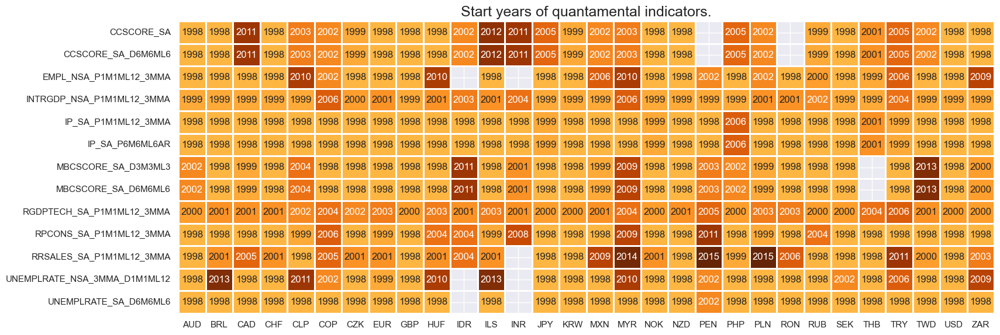

In [6]:
xcatx = econ_act
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

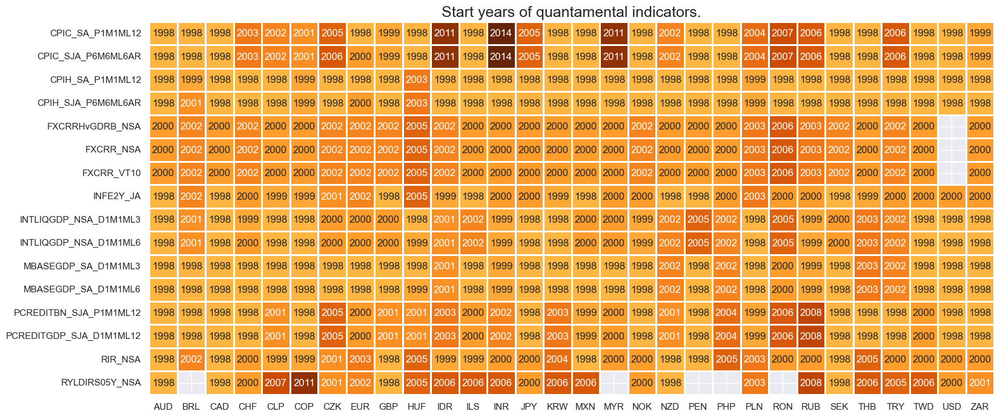

In [7]:
xcatx = mon_pol
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

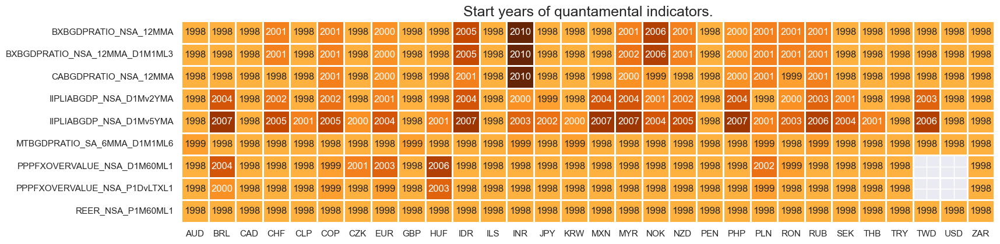

In [8]:
xcatx = ext_pos
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

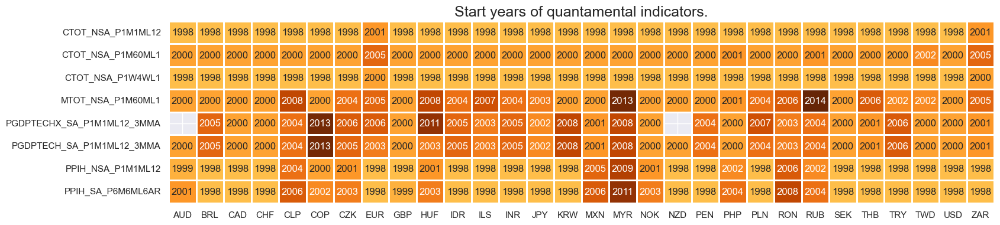

In [9]:
xcatx = price_dyn
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

### Blacklisting dictionary for empirical research

In [10]:
# Create blacklisting dictionary

dfb = df[df["xcat"].isin(["FXTARGETED_NSA", "FXUNTRADABLE_NSA"])].loc[
    :, ["cid", "xcat", "real_date", "value"]
]
dfba = (
    dfb.groupby(["cid", "real_date"])
    .aggregate(value=pd.NamedAgg(column="value", aggfunc="max"))
    .reset_index()
)
dfba["xcat"] = "FXBLACK"
fxblack = msp.make_blacklist(dfba, "FXBLACK")
fxblack

{'BRL': (Timestamp('2012-12-03 00:00:00'), Timestamp('2013-09-30 00:00:00')),
 'CHF': (Timestamp('2011-10-03 00:00:00'), Timestamp('2015-01-30 00:00:00')),
 'CZK': (Timestamp('2014-01-01 00:00:00'), Timestamp('2017-07-31 00:00:00')),
 'ILS': (Timestamp('1999-01-01 00:00:00'), Timestamp('2005-12-30 00:00:00')),
 'INR': (Timestamp('1999-01-01 00:00:00'), Timestamp('2004-12-31 00:00:00')),
 'MYR_1': (Timestamp('1999-01-01 00:00:00'), Timestamp('2007-11-30 00:00:00')),
 'MYR_2': (Timestamp('2018-07-02 00:00:00'), Timestamp('2025-02-26 00:00:00')),
 'PEN': (Timestamp('2021-07-01 00:00:00'), Timestamp('2021-07-30 00:00:00')),
 'RON': (Timestamp('1999-01-01 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_1': (Timestamp('1999-01-01 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_2': (Timestamp('2022-02-01 00:00:00'), Timestamp('2025-02-26 00:00:00')),
 'THB': (Timestamp('2007-01-01 00:00:00'), Timestamp('2008-11-28 00:00:00')),
 'TRY_1': (Timestamp('1999-01-01 00:00:00'), Timestamp('

## Factor construction and checks

In [11]:
# Initiate category dictionary for thematic factors

dict_themes = {}

# Initiate labeling dictionary

dict_lab = {}

### Economic activity factors 

In [12]:
# Governing dictionary for constituent factors

dict_ea = {
    "OUTPUT_GROWTH": {
        "INTRGDP_NSA_P1M1ML12_3MMA": ["vBM", ""],
        "RGDPTECH_SA_P1M1ML12_3MMA": ["vBM", ""],
        "IP_SA_P6M6ML6AR": ["vBM", ""],
        "IP_SA_P1M1ML12_3MMA": ["vBM", ""],
    },
    "MBC_CHANGE": {
        "MBCSCORE_SA_D3M3ML3": ["", ""],
        "MBCSCORE_SA_D6M6ML6": ["", ""],
    },
    "LAB_TIGHT": {
        "EMPL_NSA_P1M1ML12_3MMA": ["vBM", ""],
        "UNEMPLRATE_NSA_3MMA_D1M1ML12": ["vBM", "_NEG"],
        "UNEMPLRATE_SA_D6M6ML6": ["vBM", "_NEG"],
    },
    "CONS_GROWTH": {
        "RPCONS_SA_P1M1ML12_3MMA": ["vBM", ""],
        "CCSCORE_SA": ["vBM", ""],
        "CCSCORE_SA_D6M6ML6": ["vBM", ""],
        "RRSALES_SA_P1M1ML12_3MMA": ["vBM", ""],
    },
}

# Dictionary for transformed category names

dicx_ea = {}

In [13]:
# Add labels (in final transformed form)

dict_lab["OUTPUT_GROWTHZN"] = "Relative output growth"
dict_lab["MBC_CHANGEZN"] = "Industry confidence change"
dict_lab["LAB_TIGHTZN"] = "Relative labor tightening"
dict_lab["CONS_GROWTHZN"] = "Relative consumption growth"

dict_lab["INTRGDP_NSA_P1M1ML12_3MMAvBMZN"] = "Intuitive GDP nowcast, %oya, 3mma, relative"
dict_lab["RGDPTECH_SA_P1M1ML12_3MMAvBMZN"] = "Technical GDP nowcast, %oya, 3mma, relative"
dict_lab["IP_SA_P6M6ML6ARvBMZN"] = "Industry output, %6m/6m, saar, relative"
dict_lab["IP_SA_P1M1ML12_3MMAvBMZN"] = "Industry output, %oya, 3mma, relative"

dict_lab["MBCSCORE_SA_D3M3ML3ZN"] = "Industry confidence, diff 3m/3m, sa"
dict_lab["MBCSCORE_SA_D6M6ML6ZN"] = "Industry confidence, diff 6m/6m, sa"

dict_lab["EMPL_NSA_P1M1ML12_3MMAvBMZN"] = "Employment, %oya, 3mma, relative"
dict_lab["UNEMPLRATE_NSA_3MMA_D1M1ML12vBM_NEGZN"] = "Unempl. rate, diff oya, 3mma, relative, negative"
dict_lab["UNEMPLRATE_SA_D6M6ML6vBM_NEGZN"] = "Unempl. rate, diff 6m/6m, sa, relative, negative"

dict_lab["RPCONS_SA_P1M1ML12_3MMAvBMZN"] = "Real private consumption, %oya, 3mma, relative"
dict_lab["CCSCORE_SAvBMZN"] = "Consumer confidence, sa, relative"
dict_lab["CCSCORE_SA_D6M6ML6vBMZN"] = "Consumer confidence, diff 6m/6m, sa, relative"
dict_lab["RRSALES_SA_P1M1ML12_3MMAvBMZN"] = "Real retail sales, %oya, 3mma, relative"


In [14]:
# Production of factors and thematic factors

dix = dict_ea
dicx = dicx_ea

for fact in dix.keys():

    # Original factors

    xcatx = list(dix[fact].keys())
    dicx[fact] = {}
    dicx[fact]["OR"] = xcatx


    # Relatives to benchmark (if required)

    vbms = [values[0] for values in dix[fact].values()]
    xcatxx = [xc for xc, bm in zip(xcatx, vbms) if bm == "vBM"]

    if len(xcatxx) > 0:
        dfa_usd = msp.make_relative_value(
            dfx, xcatxx, cids_usd, basket=["USD"], postfix="vBM"
        )
        dfa_eur = msp.make_relative_value(
            dfx, xcatxx, cids_eur, basket=["EUR"], postfix="vBM"
        )
        dfa_eud = msp.make_relative_value(
            dfx, xcatxx, cids_eud, basket=["EUR", "USD"], postfix="vBM"
        )
        dfa = pd.concat([dfa_eur, dfa_usd, dfa_eud])
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["BM"] = [xc + bm for xc, bm in zip(xcatx, vbms)]

    # Sign for hypothesized positive relation

    xcatxx = dicx[fact]["BM"]
    negs = [values[1] for values in dix[fact].values()]
    calcs = []

    for xc, neg in zip(xcatxx, negs):
        if neg == "_NEG":
            calcs += [f"{xc}_NEG = - {xc}"]

    if len(calcs) > 0:
        dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx)
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["SG"] = [xc + neg for xc, neg in zip(xcatxx, negs)]

    # Sequential scoring

    xcatxx = dicx[fact]["SG"]
    cidx = cids_fx
    dfa = pd.DataFrame(columns=list(dfx.columns))

    for xc in xcatxx:
        dfaa = msp.make_zn_scores(
            dfx,
            xcat=xc,
            cids=cidx,
            sequential=True,
            min_obs=261 * 3,
            neutral="zero",
            pan_weight=1,
            thresh=3,
            postfix="ZN",
            est_freq="m",
        )
        dfa = msm.update_df(dfa, dfaa)

    dfx = msm.update_df(dfx, dfa)
    dicx[fact]["ZN"] = [xc + "ZN" for xc in xcatxx]

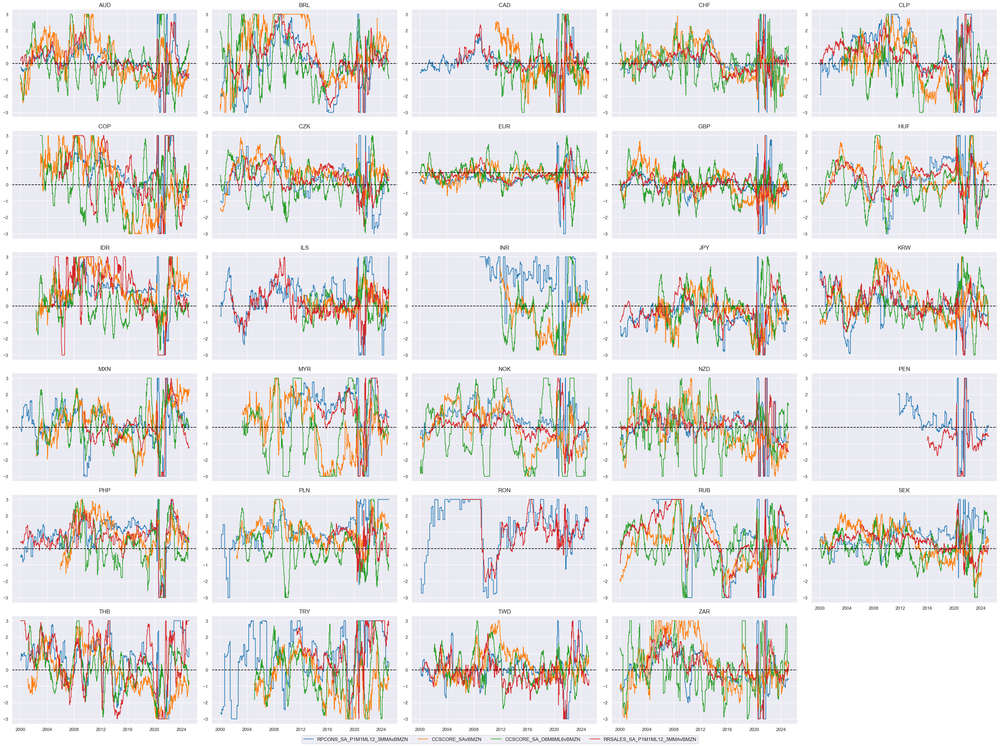

In [15]:
# Checking original and modified constituents

fact = "CONS_GROWTH"  # "OUTPUT_GROWTH", "MBC_CHANGE", "LAB_TIGHT", "CONS_GROWTH"
xcatx = dicx_ea[fact]["ZN"]  # "OR", "BM", "SG", "ZN"
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

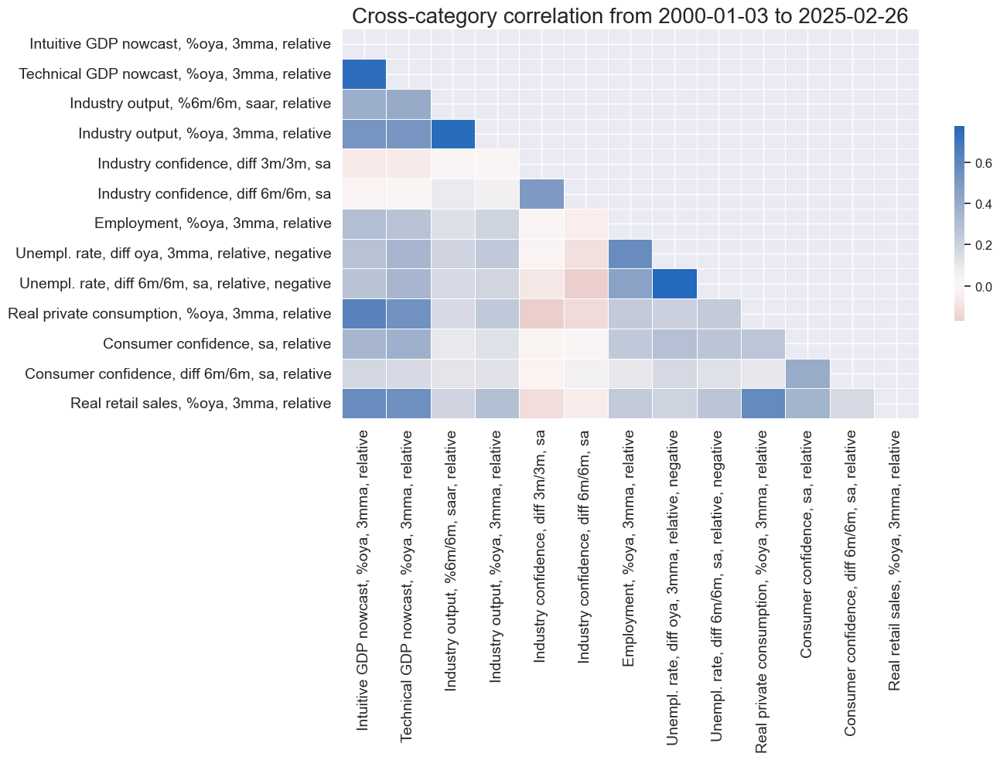

In [16]:
# Correlation matrix of final constituents

xcatx = [item for value in dicx_ea.values() if 'ZN' in value for item in value['ZN']]
cidx = cids_fx
sdate = "2000-01-01"
labels = [dict_lab[xc] for xc in xcatx]


msp.correl_matrix(
    dfx,
    xcats=xcatx,
    cids=cidx,
    start=sdate,
    freq="M",
    cluster=False,
    title=None,
    size=(14, 10),
    xcat_labels=labels,
)

In [17]:
# Factors and re-scoring
dicx = dicx_ea
cidx = cids_fx

factors = list(dicx.keys())

# Factors as average of constituent scores

for fact in factors:
    xcatx = dicx[fact]["ZN"]

    dfa = msp.linear_composite(
        dfx,
        xcats=xcatx,
        cids=cidx,
        complete_xcats=False,
        new_xcat=fact,
    )
    dfx = msm.update_df(dfx, dfa)

# Sequential re-scoring

dfa = pd.DataFrame(columns=list(dfx.columns))

for fact in factors:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=fact,
        cids=cidx,
        sequential=True,
        min_obs=261 * 3,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)

dict_themes["REL_ECON_GROWTH"] = [fact + "ZN" for fact in factors]


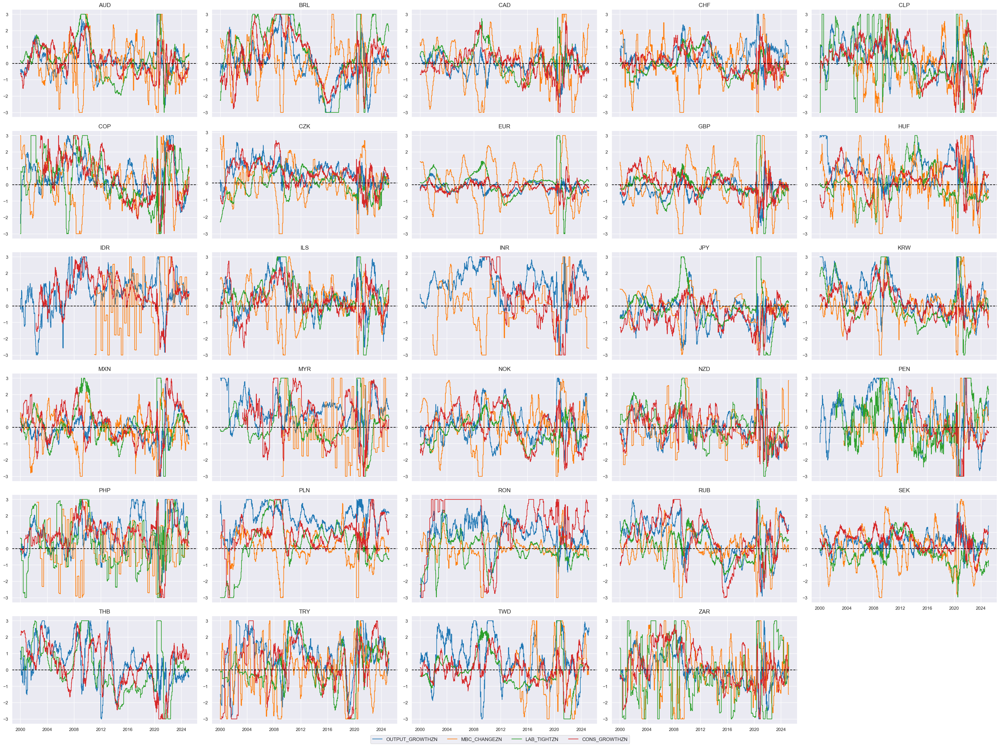

In [18]:
# Checking constituent factor timelines

xcatx = dict_themes["REL_ECON_GROWTH"]
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

### Monetary policy factors

In [19]:
# Preparation of categories for constituent factors

cidx = cids

# Preparation: for relative target deviations, we need denominator bases that should never be less than 2

dfa = msp.panel_calculator(df, ["INFTEBASIS = INFTEFF_NSA.clip(lower=2)"], cids=cidx)
dfx = msm.update_df(dfx, dfa)

xcatx = cpi_inf + pcredit_growth


calcs = [f"XR{xc} = ( {xc} - INFTEFF_NSA ) / INFTEBASIS" for xc in xcatx]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cidx)
dfx = msm.update_df(dfx, dfa)

In [20]:
# Governing dictionary for constituent factors

dict_mp = {
    "EXCESS_INFLATION": {
        "XRCPIH_SA_P1M1ML12": ["vBM", ""],
        "XRCPIH_SJA_P6M6ML6AR": ["vBM", ""],
        "XRCPIC_SA_P1M1ML12": ["vBM", ""],
        "XRCPIC_SJA_P6M6ML6AR": ["vBM", ""],
        "XRINFE2Y_JA": ["vBM", ""],
    },
    "XPCREDIT_GROWTH": {
        "XRPCREDITBN_SJA_P1M1ML12": ["vBM", ""],
        "XRPCREDITGDP_SJA_D1M1ML12": ["vBM", ""],
    },
    "REAL_RATES": {
        "RIR_NSA": ["vBM", ""],
        "RYLDIRS05Y_NSA": ["vBM", ""],
        "FXCRR_NSA": ["", ""],
        "FXCRR_VT10": ["", ""],
        "FXCRRHvGDRB_NSA": ["", ""],
    },
    "LIQ_TIGHT": {
        "MBASEGDP_SA_D1M1ML3": ["vBM", "_NEG"],
        "MBASEGDP_SA_D1M1ML6": ["vBM", "_NEG"],
        "INTLIQGDP_NSA_D1M1ML3": ["vBM", "_NEG"],
        "INTLIQGDP_NSA_D1M1ML6": ["vBM", "_NEG"],
    },
}

# Dictionary for transformed category names

dicx_mp = {}

In [21]:
# Add labels (in final transformed form)

dict_lab["EXCESS_INFLATIONZN"] = "Relative excess inflation ratios"
dict_lab["XPCREDIT_GROWTHZN"] = "Relative excess credit growth"
dict_lab["REAL_RATESZN"] = "Real rate differentials and carry"
dict_lab["LIQ_TIGHTZN"] = "Relative liquidity tightening"

dict_lab["XRCPIH_SA_P1M1ML12vBMZN"] = "Excess headline CPI inflation, %oya, relative"
dict_lab["XRCPIH_SJA_P6M6ML6ARvBMZN"] = "Excess headline CPI inflation, %6m/6m, saar, relative"
dict_lab["XRCPIC_SA_P1M1ML12vBMZN"] = "Excess core CPI inflation, %oya, relative"
dict_lab["XRCPIC_SJA_P6M6ML6ARvBMZN"] = "Excess core CPI inflation, %6m/6m, saar, relative"
dict_lab["XRINFE2Y_JAvBMZN"] = "Excess 2-year inflation expectations, %, relative"

dict_lab["XRPCREDITBN_SJA_P1M1ML12vBMZN"] = "Excess private credit growth, %oya, relative"
dict_lab["XRPCREDITGDP_SJA_D1M1ML12vBMZN"] = "Excess private credit growth, diff as % of GDP, relative"

dict_lab["RIR_NSAvBMZN"] = "Real 1-month interest rate differential"
dict_lab["RYLDIRS05Y_NSAvBMZN"] = "Real 5-year IRS yield differential"
dict_lab["FXCRR_NSAZN"] = "Real FX forward carry"
dict_lab["FXCRR_VT10ZN"] = "Real FX forward carry for 10% ar vol target"
dict_lab["FXCRRHvGDRB_NSAZN"] = "Real hedged FX forward carry"

dict_lab["MBASEGDP_SA_D1M1ML3vBM_NEGZN"] = "Monetary base, as % of GDP, diff over 3m, relative, negative"
dict_lab["MBASEGDP_SA_D1M1ML6vBM_NEGZN"] = "Monetary base, as % of GDP, diff over 6m, relative, negative"
dict_lab["INTLIQGDP_NSA_D1M1ML3vBM_NEGZN"] = "Intervention liquidity, as % of GDP, %oya, 3mma, relative, negative"
dict_lab["INTLIQGDP_NSA_D1M1ML6vBM_NEGZN"] = "Intervention liquidity, as % of GDP, %oya, 6mma, relative, negative"

In [22]:
# Production of factors and thematic factors

dix = dict_mp
dicx = dicx_mp

for fact in dix.keys():

    # Original factors

    xcatx = list(dix[fact].keys())
    dicx[fact] = {}
    dicx[fact]["OR"] = xcatx


    # Relatives to benchmark (if required)

    vbms = [values[0] for values in dix[fact].values()]
    xcatxx = [xc for xc, bm in zip(xcatx, vbms) if bm == "vBM"]

    if len(xcatxx) > 0:
        dfa_usd = msp.make_relative_value(
            dfx, xcatxx, cids_usd, basket=["USD"], postfix="vBM"
        )
        dfa_eur = msp.make_relative_value(
            dfx, xcatxx, cids_eur, basket=["EUR"], postfix="vBM"
        )
        dfa_eud = msp.make_relative_value(
            dfx, xcatxx, cids_eud, basket=["EUR", "USD"], postfix="vBM"
        )
        dfa = pd.concat([dfa_eur, dfa_usd, dfa_eud])
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["BM"] = [xc + bm for xc, bm in zip(xcatx, vbms)]

    # Sign for hypothesized positive relation

    xcatxx = dicx[fact]["BM"]
    negs = [values[1] for values in dix[fact].values()]
    calcs = []

    for xc, neg in zip(xcatxx, negs):
        if neg == "_NEG":
            calcs += [f"{xc}_NEG = - {xc}"]

    if len(calcs) > 0:
        dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx)
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["SG"] = [xc + neg for xc, neg in zip(xcatxx, negs)]

    # Sequential scoring

    xcatxx = dicx[fact]["SG"]
    cidx = cids_fx
    dfa = pd.DataFrame(columns=list(dfx.columns))

    for xc in xcatxx:
        dfaa = msp.make_zn_scores(
            dfx,
            xcat=xc,
            cids=cidx,
            sequential=True,
            min_obs=261 * 3,
            neutral="zero",
            pan_weight=1,
            thresh=3,
            postfix="ZN",
            est_freq="m",
        )
        dfa = msm.update_df(dfa, dfaa)

    dfx = msm.update_df(dfx, dfa)
    dicx[fact]["ZN"] = [xc + "ZN" for xc in xcatxx]

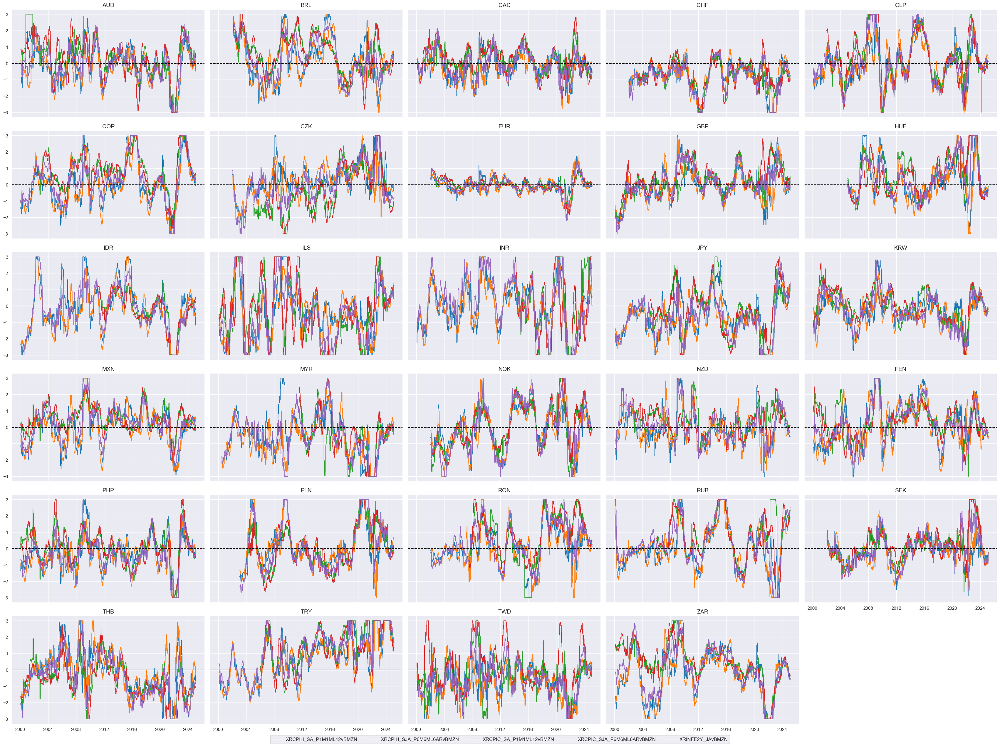

In [23]:
# Checking original and modified constituents

fact = "EXCESS_INFLATION"  # "EXCESS_INFLATION", "XPCREDIT_GROWTH", "REAL_RATES", "LIQ_TIGHT"
xcatx = dicx_mp[fact]["ZN"]  # "OR", "BM", "SG", "ZN"
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=True,
    ncol=5,
    title = None,
    xcat_labels = None
)

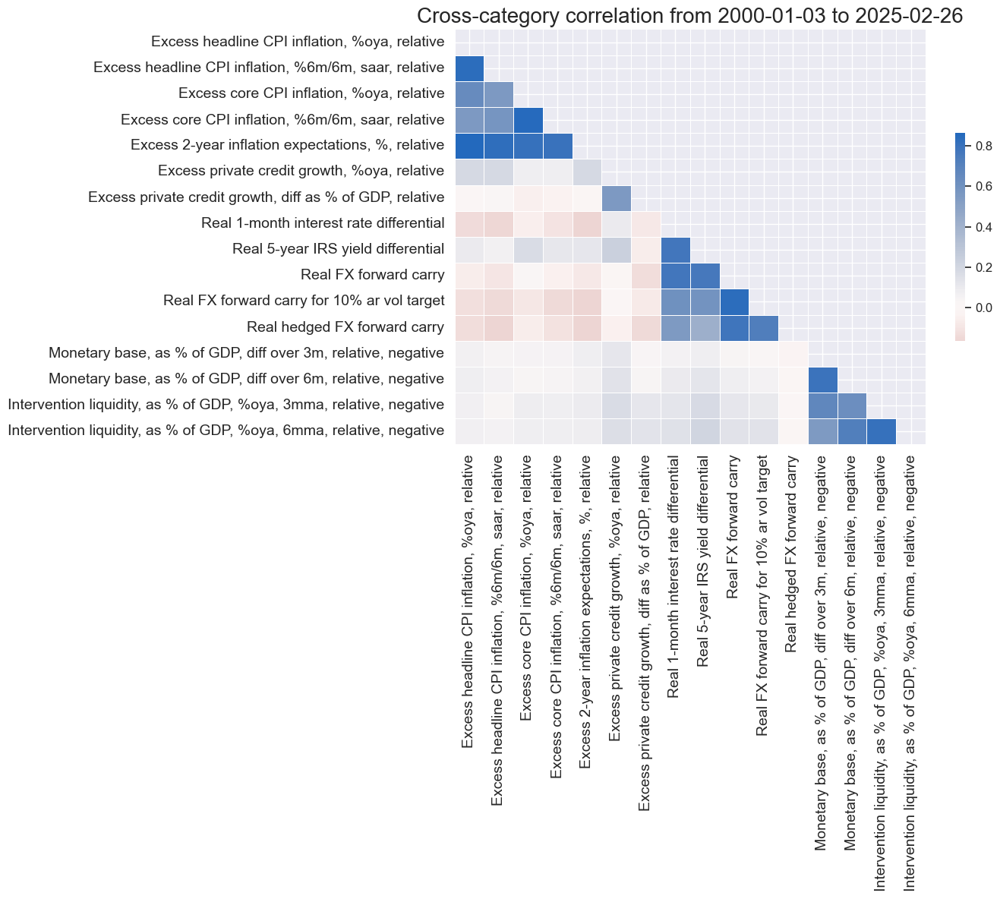

In [24]:
# Correlation matrix of final constituents

xcatx = [item for value in dicx_mp.values() if 'ZN' in value for item in value['ZN']]
cidx = cids_fx
sdate = "2000-01-01"
labels = [dict_lab[xc] for xc in xcatx]


msp.correl_matrix(
    dfx,
    xcats=xcatx,
    cids=cidx,
    start=sdate,
    freq="M",
    cluster=False,
    title=None,
    size=(14, 12),
    xcat_labels=labels,
)

In [25]:
# Factors and re-scoring
dicx = dicx_mp
cidx = cids_fx

factors = list(dicx.keys())

# Factors as average of constituent scores

for fact in factors:
    xcatx = dicx[fact]["ZN"]

    dfa = msp.linear_composite(
        dfx,
        xcats=xcatx,
        cids=cidx,
        complete_xcats=False,
        new_xcat=fact,
    )
    dfx = msm.update_df(dfx, dfa)

# Sequential re-scoring

dfa = pd.DataFrame(columns=list(dfx.columns))

for fact in factors:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=fact,
        cids=cidx,
        sequential=True,
        min_obs=261 * 3,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)

dict_themes["REL_MONPOL_TIGHT"] = [fact + "ZN" for fact in factors]

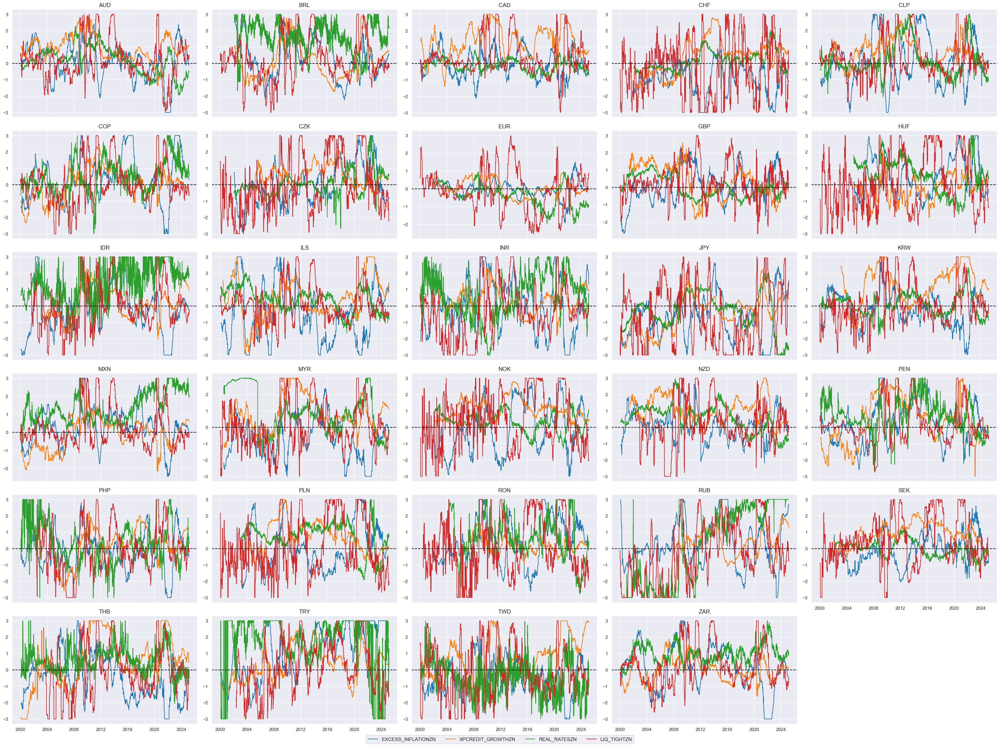

In [26]:
# Checking constituent factor timelines

xcatx = dict_themes["REL_MONPOL_TIGHT"]
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

### External position and valuation factors

In [27]:
# Governing dictionary for constituent factors

dict_xv = {
    "EXTERNAL_BALANCES": {
        "CABGDPRATIO_NSA_12MMA": ["", ""],
        "BXBGDPRATIO_NSA_12MMA": ["", ""],
        "MTBGDPRATIO_SA_6MMA_D1M1ML6": ["", ""],
        "BXBGDPRATIO_NSA_12MMA_D1M1ML3": ["", ""],
    },
    "LIABILITIES_GROWTH": {
        "IIPLIABGDP_NSA_D1Mv2YMA": ["", "_NEG"],
        "IIPLIABGDP_NSA_D1Mv5YMA": ["", "_NEG"],
    },
    "FX_OVERVAL": {
        "PPPFXOVERVALUE_NSA_P1DvLTXL1": ["", "_NEG"],
        "PPPFXOVERVALUE_NSA_D1M60ML1": ["", "_NEG"],
        "REER_NSA_P1M60ML1": ["", "_NEG"],
    },
}

# Dictionary for transformed category names

dicx_xv = {}

In [28]:
# Add labels (in final transformed form)

dict_lab["EXTERNAL_BALANCESZN"] = "External balances ratios"
dict_lab["LIABILITIES_GROWTHZN"] = "Liabilities growth (negative)"
dict_lab["FX_OVERVALZN"] = "FX overvaluation (negative)"

dict_lab["CABGDPRATIO_NSA_12MMAZN"] = "Current account balance, % of GDP, 12mma"
dict_lab["BXBGDPRATIO_NSA_12MMAZN"] = "Basic external balance, % of GDP, 12mma"
dict_lab["MTBGDPRATIO_SA_6MMA_D1M1ML6ZN"] = "Change in trade balance, diff 6m/6m, sa"
dict_lab["BXBGDPRATIO_NSA_12MMA_D1M1ML3ZN"] = "Basic ext. balance, % of GDP, 12mma, diff over 3m"

dict_lab["IIPLIABGDP_NSA_D1Mv2YMA_NEGZN"] = "International liabilities, % of GDP, diff over 2yma"
dict_lab["IIPLIABGDP_NSA_D1Mv5YMA_NEGZN"] = "International liabilities, % of GDP, diff over 5yma"

dict_lab["PPPFXOVERVALUE_NSA_P1DvLTXL1_NEGZN"] = "PPP-based overvaluation, % versus long-term median, negative"
dict_lab["PPPFXOVERVALUE_NSA_D1M60ML1_NEGZN"] = "PPP-based overvaluation, % diff over 5yma negative"
dict_lab["REER_NSA_P1M60ML1_NEGZN"] = "REER appreciation, % diff over 5yma negative"

In [29]:
# Production of factors and thematic factors

dix = dict_xv
dicx = dicx_xv

for fact in dix.keys():

    # Original factors

    xcatx = list(dix[fact].keys())
    dicx[fact] = {}
    dicx[fact]["OR"] = xcatx


    # Relatives to benchmark (if required)

    vbms = [values[0] for values in dix[fact].values()]
    xcatxx = [xc for xc, bm in zip(xcatx, vbms) if bm == "vBM"]

    if len(xcatxx) > 0:
        dfa_usd = msp.make_relative_value(
            dfx, xcatxx, cids_usd, basket=["USD"], postfix="vBM"
        )
        dfa_eur = msp.make_relative_value(
            dfx, xcatxx, cids_eur, basket=["EUR"], postfix="vBM"
        )
        dfa_eud = msp.make_relative_value(
            dfx, xcatxx, cids_eud, basket=["EUR", "USD"], postfix="vBM"
        )
        dfa = pd.concat([dfa_eur, dfa_usd, dfa_eud])
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["BM"] = [xc + bm for xc, bm in zip(xcatx, vbms)]

    # Sign for hypothesized positive relation

    xcatxx = dicx[fact]["BM"]
    negs = [values[1] for values in dix[fact].values()]
    calcs = []

    for xc, neg in zip(xcatxx, negs):
        if neg == "_NEG":
            calcs += [f"{xc}_NEG = - {xc}"]

    if len(calcs) > 0:
        dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx)
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["SG"] = [xc + neg for xc, neg in zip(xcatxx, negs)]

    # Sequential scoring

    xcatxx = dicx[fact]["SG"]
    cidx = cids_fx
    dfa = pd.DataFrame(columns=list(dfx.columns))

    for xc in xcatxx:
        dfaa = msp.make_zn_scores(
            dfx,
            xcat=xc,
            cids=cidx,
            sequential=True,
            min_obs=261 * 3,
            neutral="zero",
            pan_weight=1,
            thresh=3,
            postfix="ZN",
            est_freq="m",
        )
        dfa = msm.update_df(dfa, dfaa)

    dfx = msm.update_df(dfx, dfa)
    dicx[fact]["ZN"] = [xc + "ZN" for xc in xcatxx]

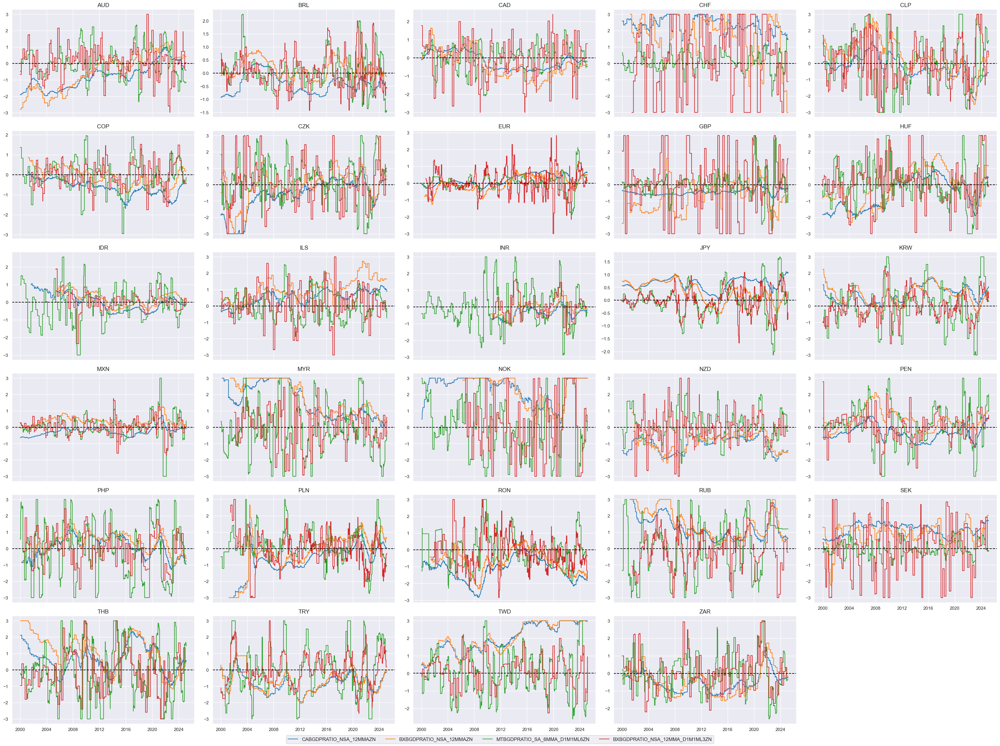

In [30]:
# Checking original and modified constituents

fact = "EXTERNAL_BALANCES"  # "EXTERNAL_BALANCES", "LIABILITIES_GROWTH", "FX_OVERVAL"
xcatx = dicx_xv[fact]["ZN"]  # "OR", "BM", "SG", "ZN"
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

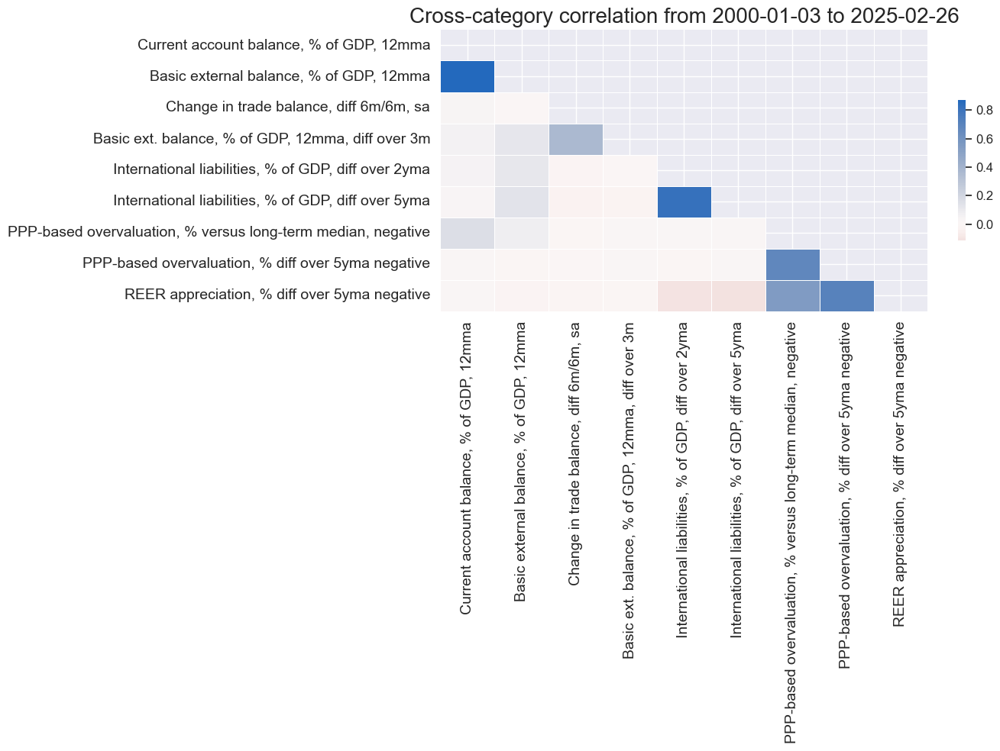

In [31]:
# Correlation matrix of final constituents

xcatx = [item for value in dicx_xv.values() if 'ZN' in value for item in value['ZN']]
cidx = cids_fx
sdate = "2000-01-01"
labels = [dict_lab[xc] for xc in xcatx]

msp.correl_matrix(
    dfx,
    xcats=xcatx,
    cids=cidx,
    start=sdate,
    freq="M",
    cluster=False,
    title=None,
    size=(14, 10),
    xcat_labels=labels,
)

In [32]:
# Factors and re-scoring
dicx = dicx_xv
cidx = cids_fx

factors = list(dicx.keys())

# Factors as average of constituent scores

for fact in factors:
    xcatx = dicx[fact]["ZN"]

    dfa = msp.linear_composite(
        dfx,
        xcats=xcatx,
        cids=cidx,
        complete_xcats=False,
        new_xcat=fact,
    )
    dfx = msm.update_df(dfx, dfa)

# Sequential re-scoring

dfa = pd.DataFrame(columns=list(dfx.columns))

for fact in factors:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=fact,
        cids=cidx,
        sequential=True,
        min_obs=261 * 3,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)

dict_themes["EXTERNAL_VALUE"] = [fact + "ZN" for fact in factors]

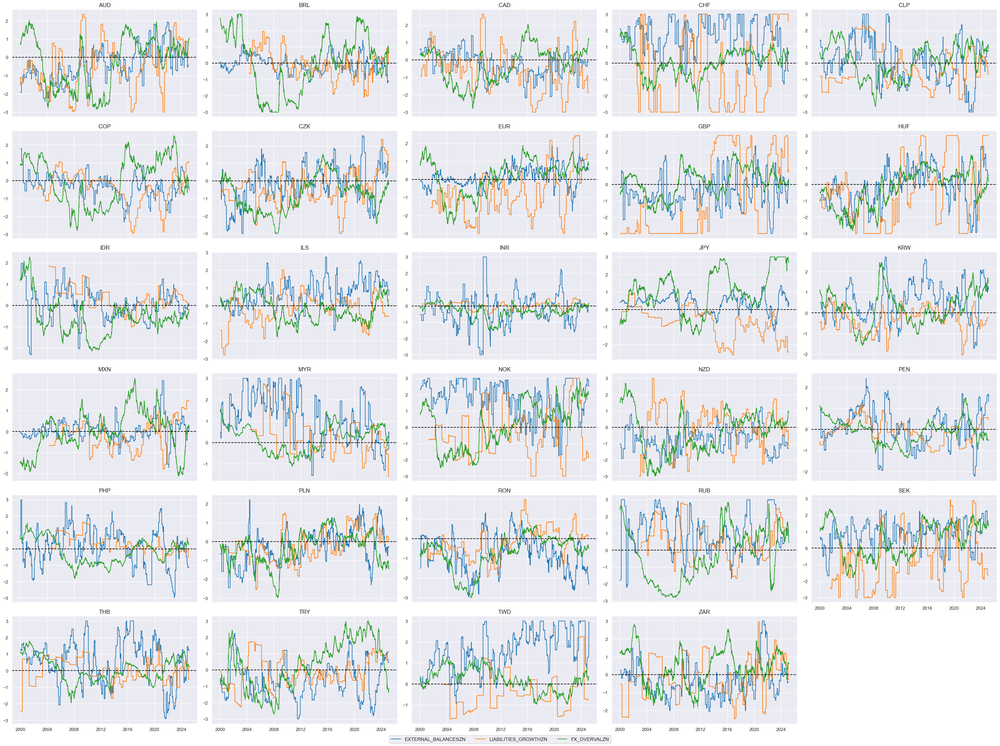

In [33]:
# Checking constituent factor timelines

xcatx = dict_themes["EXTERNAL_VALUE"]
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

### Price competitiveness factors

In [34]:
# Preparation of categories for constituent factors

xcatx = ppi_pchange
cidx = cids

calcs = [f"XR{xc} = ( {xc} - INFTEFF_NSA ) / INFTEBASIS" for xc in xcatx]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cidx)
dfx = msm.update_df(dfx, dfa)

In [35]:
# Governing dictionary for constituent factors

dict_pc = {
    "EXCESS_PPIGROWTH": {
        "XRPGDPTECH_SA_P1M1ML12_3MMA": ["vBM", ""],
        "XRPPIH_NSA_P1M1ML12": ["vBM", ""],
    },
    "TOT_CHANGE": {
        "CTOT_NSA_P1W4WL1": ["", ""],
        "CTOT_NSA_P1M1ML12": ["", ""],
        "CTOT_NSA_P1M60ML1": ["", ""],
        "MTOT_NSA_P1M60ML1": ["", ""],
    },
}

# Dictionary for transformed category names

dicx_pc = {}

In [36]:
dict_lab["EXCESS_PPIGROWTHZN"] = "Relative excess producer price growth"
dict_lab["TOT_CHANGEZN"] = "Terms of change improvement"

dict_lab["XRPGDPTECH_SA_P1M1ML12_3MMAvBMZN"] = "Excess GDP deflator growth, %oya, 3mma, relative"
dict_lab["XRPPIH_NSA_P1M1ML12vBMZN"] = "Excess PPI inflation, %oya, relative"

dict_lab["CTOT_NSA_P1W4WL1ZN"] = "Commodity terms of trade, % over prev. 4 weeks"
dict_lab["CTOT_NSA_P1M1ML12ZN"] = "Commodity terms of trade, % over prev. 12 months"
dict_lab["CTOT_NSA_P1M60ML1ZN"] = "Commodity terms of trade, % over prev. 5 years"
dict_lab["MTOT_NSA_P1M60ML1ZN"] = "Broad terms of trade, % over prev. 5 years"

In [37]:
# Production of factors and thematic factors

dix = dict_pc
dicx = dicx_pc

for fact in dix.keys():

    # Original factors

    xcatx = list(dix[fact].keys())
    dicx[fact] = {}
    dicx[fact]["OR"] = xcatx


    # Relatives to benchmark (if required)

    vbms = [values[0] for values in dix[fact].values()]
    xcatxx = [xc for xc, bm in zip(xcatx, vbms) if bm == "vBM"]

    if len(xcatxx) > 0:
        dfa_usd = msp.make_relative_value(
            dfx, xcatxx, cids_usd, basket=["USD"], postfix="vBM"
        )
        dfa_eur = msp.make_relative_value(
            dfx, xcatxx, cids_eur, basket=["EUR"], postfix="vBM"
        )
        dfa_eud = msp.make_relative_value(
            dfx, xcatxx, cids_eud, basket=["EUR", "USD"], postfix="vBM"
        )
        dfa = pd.concat([dfa_eur, dfa_usd, dfa_eud])
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["BM"] = [xc + bm for xc, bm in zip(xcatx, vbms)]

    # Sign for hypothesized positive relation

    xcatxx = dicx[fact]["BM"]
    negs = [values[1] for values in dix[fact].values()]
    calcs = []

    for xc, neg in zip(xcatxx, negs):
        if neg == "_NEG":
            calcs += [f"{xc}_NEG = - {xc}"]

    if len(calcs) > 0:
        dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx)
        dfx = msm.update_df(dfx, dfa)

    dicx[fact]["SG"] = [xc + neg for xc, neg in zip(xcatxx, negs)]

    # Sequential scoring

    xcatxx = dicx[fact]["SG"]
    cidx = cids_fx
    dfa = pd.DataFrame(columns=list(dfx.columns))

    for xc in xcatxx:
        dfaa = msp.make_zn_scores(
            dfx,
            xcat=xc,
            cids=cidx,
            sequential=True,
            min_obs=261 * 3,
            neutral="zero",
            pan_weight=1,
            thresh=3,
            postfix="ZN",
            est_freq="m",
        )
        dfa = msm.update_df(dfa, dfaa)

    dfx = msm.update_df(dfx, dfa)
    dicx[fact]["ZN"] = [xc + "ZN" for xc in xcatxx]

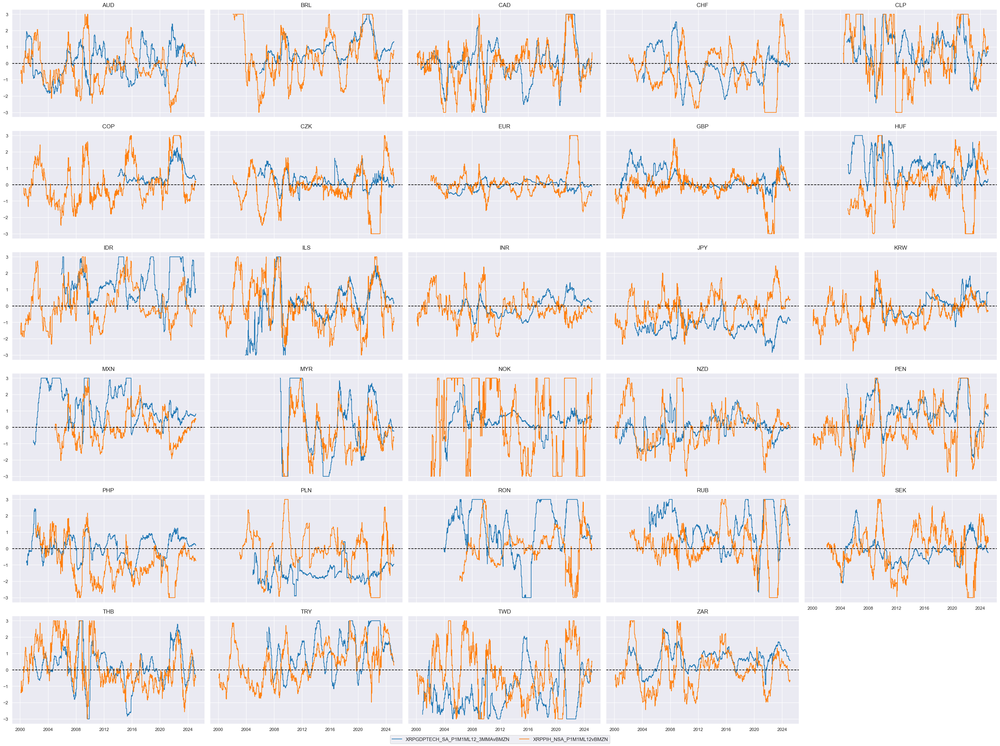

In [38]:
# Checking original and modified constituents

fact = "EXCESS_PPIGROWTH"  # "EXCESS_PPIGROWTH", "TOT_CHANGE"
xcatx = dicx_pc[fact]["ZN"]  # "OR", "BM", "SG", "ZN"
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=True,
    ncol=5,
    title = None,
    xcat_labels = None
)

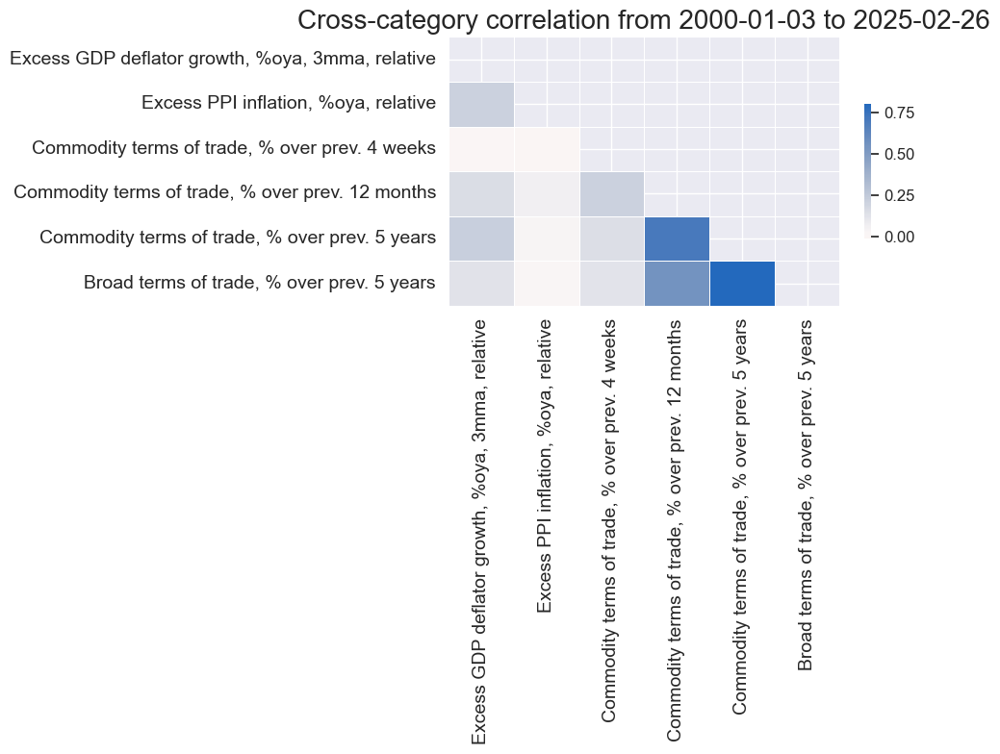

In [39]:
# Correlation matrix of final constituents

xcatx = [item for value in dicx_pc.values() if 'ZN' in value for item in value['ZN']]
cidx = cids_fx
sdate = "2000-01-01"
labels = [dict_lab[xc] for xc in xcatx]


msp.correl_matrix(
    dfx,
    xcats=xcatx,
    cids=cidx,
    start=sdate,
    freq="M",
    cluster=False,
    title=None,
    size=(10, 8),
    xcat_labels=labels,
)

In [40]:
# Factors and re-scoring
dicx = dicx_pc
cidx = cids_fx

factors = list(dicx.keys())

# Factors as average of constituent scores

for fact in factors:
    xcatx = dicx[fact]["ZN"]

    dfa = msp.linear_composite(
        dfx,
        xcats=xcatx,
        cids=cidx,
        complete_xcats=False,
        new_xcat=fact,
    )
    dfx = msm.update_df(dfx, dfa)

# Sequential re-scoring

dfa = pd.DataFrame(columns=list(dfx.columns))

for fact in factors:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=fact,
        cids=cidx,
        sequential=True,
        min_obs=261 * 3,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)

dict_themes["REL_PRICE_COMPETE"] = [fact + "ZN" for fact in factors]

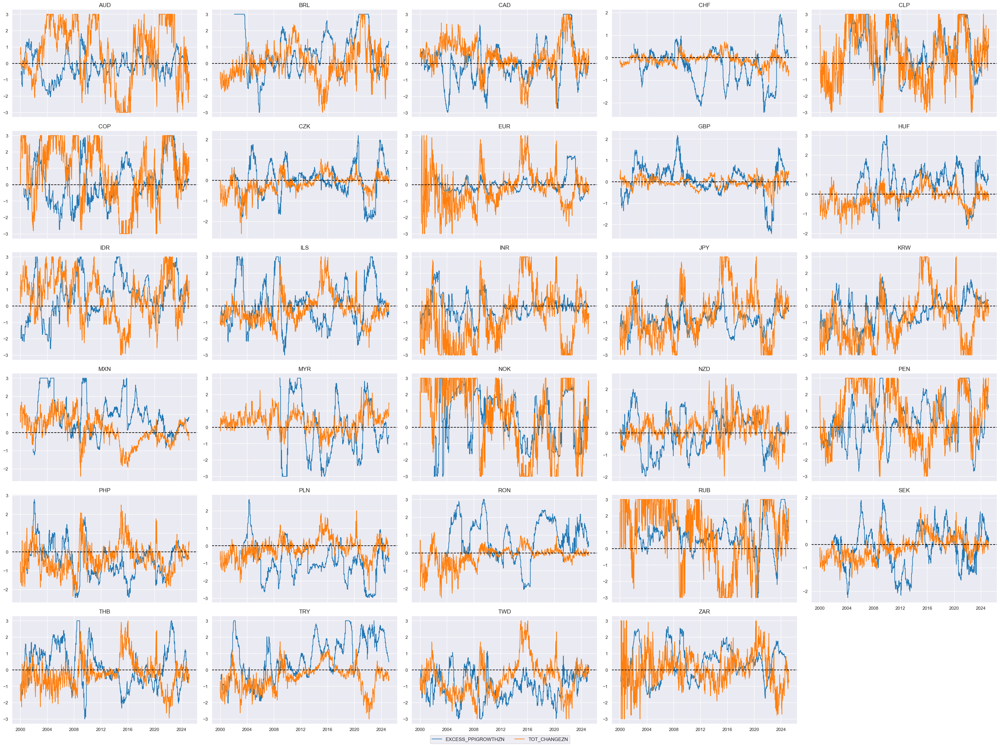

In [41]:
# Checking constituent factor timelines

xcatx = dict_themes["REL_PRICE_COMPETE"]
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

## Thematic factor calculation and checks

### Basic factor correlations

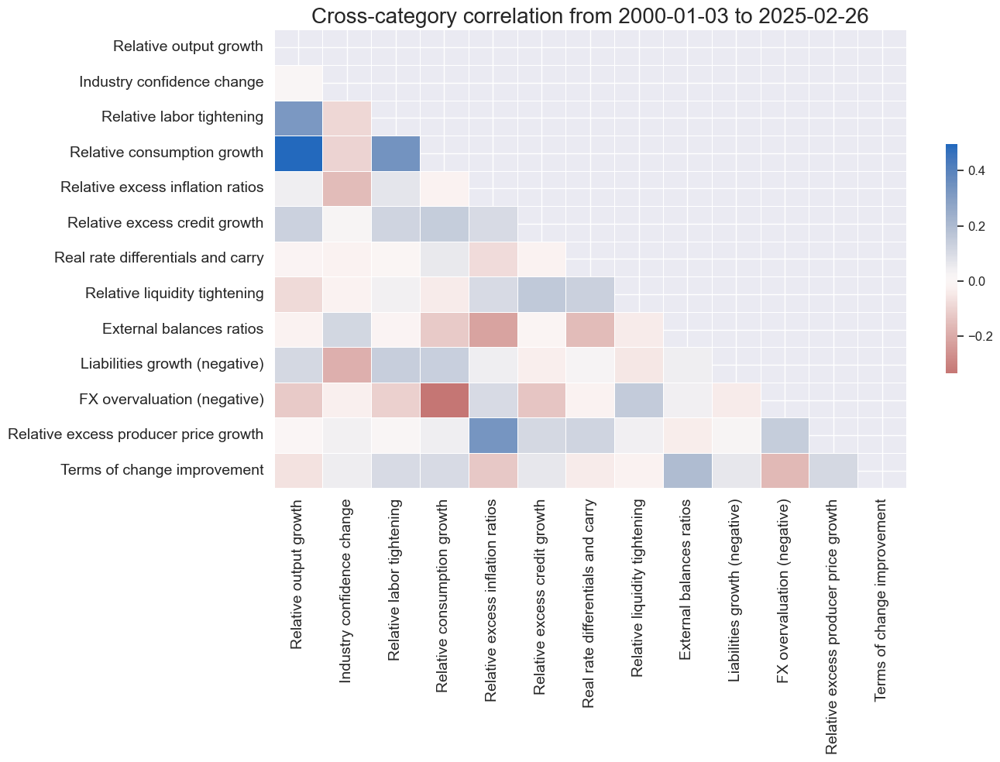

In [42]:
# Correlation matrix of basic factors

xcatx = [item for sublist in dict_themes.values() for item in sublist]
cidx = cids_fx
sdate = "2000-01-01"
labels = [dict_lab[xc] for xc in xcatx]


msp.correl_matrix(
    dfx,
    xcats=xcatx,
    cids=cidx,
    start=sdate,
    freq="M",
    cluster=False,
    title=None,
    size=(14, 10),
    xcat_labels=labels,
)

### Thematic factor calculation

In [43]:
# Themes and re-scoring

cidx = cids_fx
themes = list(dict_themes.keys())

# Themes as average of factor scores

for theme in themes:
    xcatx = dict_themes[theme]

    dfa = msp.linear_composite(
        dfx,
        xcats=xcatx,
        cids=cidx,
        complete_xcats=False,
        new_xcat=theme,
    )
    dfx = msm.update_df(dfx, dfa)

# Sequential re-scoring

dfa = pd.DataFrame(columns=list(dfx.columns))

for theme in themes:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=theme,
        cids=cidx,
        sequential=True,
        min_obs=261 * 3,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)

themez = [theme + "ZN" for theme in themes]

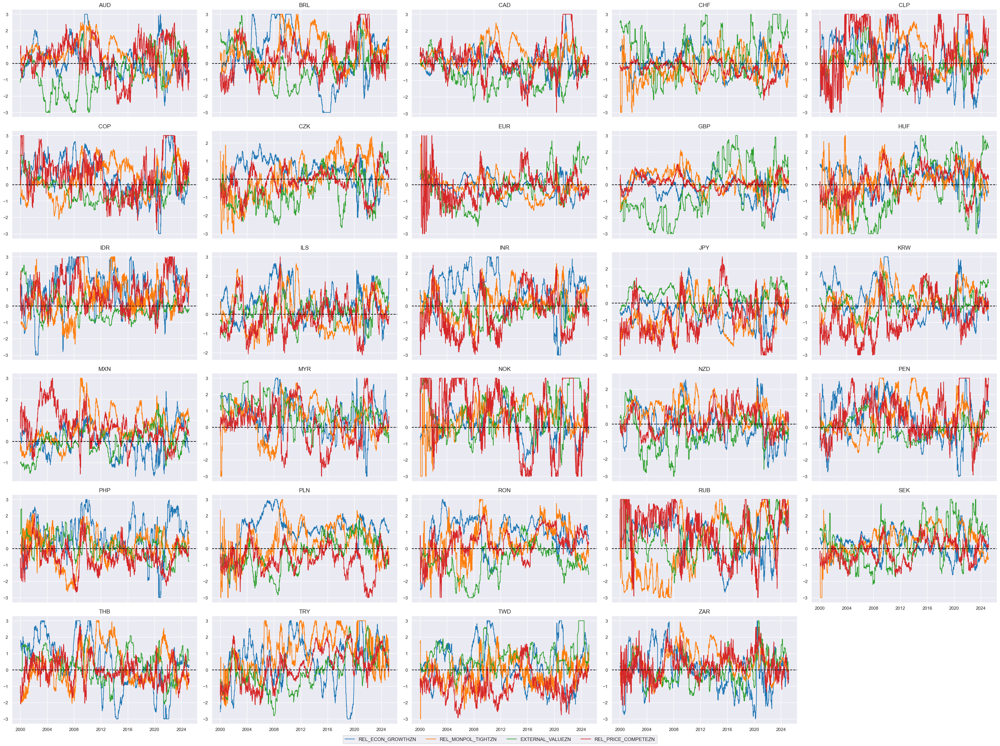

In [44]:
# Checking constituent factor timelines

xcatx = themez
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

In [45]:
dict_lab["REL_ECON_GROWTHZN"] = "Relative economic activity"
dict_lab["REL_MONPOL_TIGHTZN"] = "Relative monetary tightening bias"
dict_lab["EXTERNAL_VALUEZN"] = "External balances and valuation"
dict_lab["REL_PRICE_COMPETEZN"] = "Relative price competitiveness"
dict_lab["Composite"] = "Composite score"
labels = [dict_lab[xc] for xc in xcatx]

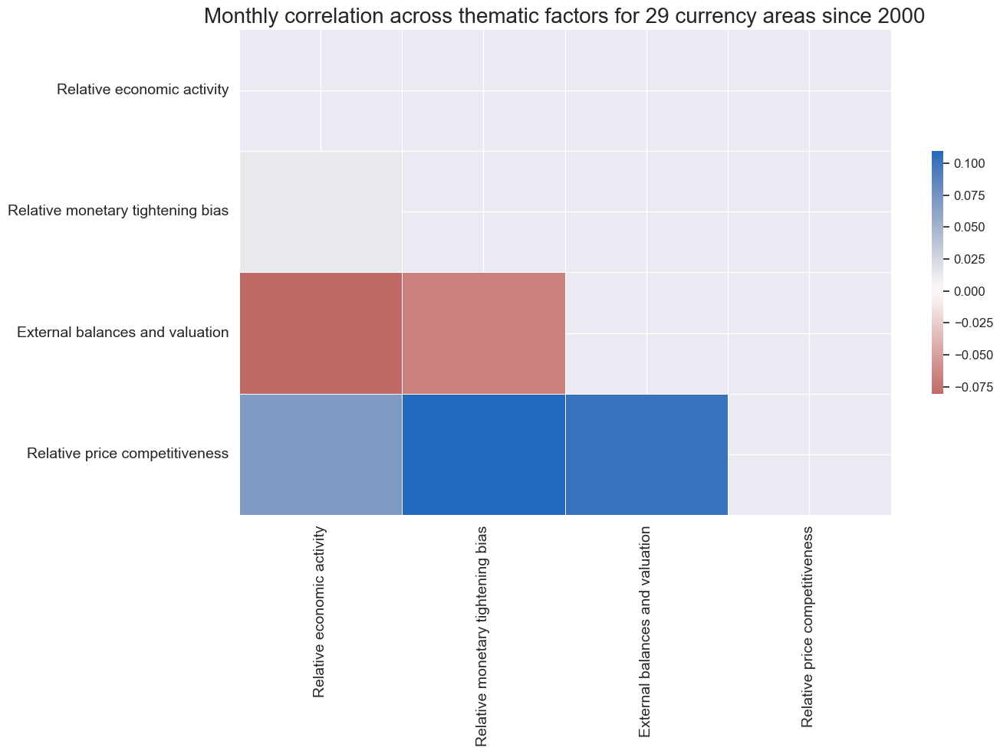

In [46]:
# Correlation of thematic factors

xcatx = themez
cidx = cids_fx
sdate = "2000-01-01"
labels = [dict_lab[xc] for xc in xcatx]

msp.correl_matrix(
    dfx,
    xcats=xcatx,
    cids=cidx,
    start=sdate,
    freq="M",
    cluster=False,
    title="Monthly correlation across thematic factors for 29 currency areas since 2000",
    size=(14, 10),
    xcat_labels=labels,
)

### Composite score calculation

In [47]:
xcatx = themez
cidx = cids_fx


dfa = msp.linear_composite(
    dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat="COMPOSITE",
)
dfx = msm.update_df(dfx, dfa)

# Sequential re-scoring

dfa = msp.make_zn_scores(
        dfx,
        xcat="COMPOSITE",
        cids=cidx,
        sequential=True,
        min_obs=261 * 3,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="ZN",
        est_freq="m",
    )

dfx = msm.update_df(dfx, dfa)


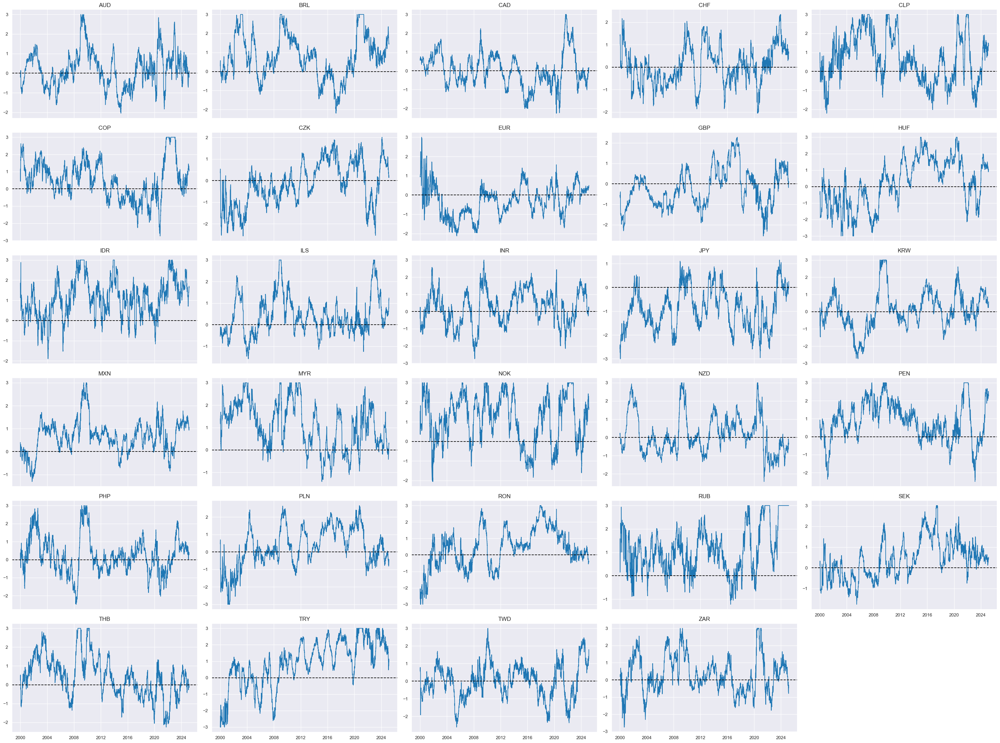

In [48]:
cidx = cids_fx

msp.view_timelines(
    df=dfx,
    xcats="COMPOSITEZN",
    cids=cidx,
    start="2000-01-01",
    aspect=1.6,
    same_y=False,
    ncol=5,
    title = None,
    xcat_labels = None
)

## Structural and labelling dictionaries

In [49]:
# Dictionary of thematic factor structure

dict_struct = {
    "REL_ECON_GROWTHZN": {
        key + "ZN": [
            "".join([sub_key] + [val for val in values if val]) + "ZN"
            for sub_key, values in sub_dict.items()
        ]
        for key, sub_dict in dict_ea.items()
    },
    "REL_MONPOL_TIGHTZN": {
        key + "ZN": [
            "".join([sub_key] + [val for val in values if val]) + "ZN"
            for sub_key, values in sub_dict.items()
        ]
        for key, sub_dict in dict_mp.items()
    },
    "EXTERNAL_VALUEZN": {
        key + "ZN": [
            "".join([sub_key] + [val for val in values if val]) + "ZN"
            for sub_key, values in sub_dict.items()
        ]
        for key, sub_dict in dict_xv.items()
    },
    "REL_PRICE_COMPETEZN": {
        key + "ZN": [
            "".join([sub_key] + [val for val in values if val]) + "ZN"
            for sub_key, values in sub_dict.items()
        ]
        for key, sub_dict in dict_pc.items()
    },
}


In [50]:
# Create dictionary of subordinate factors and constituents

dict_struct_flat = {
    sub_key: values
    for main_key, sub_dict in dict_struct.items()
    for sub_key, values in sub_dict.items()
}

## Global condensed scorecard

### Snapshot

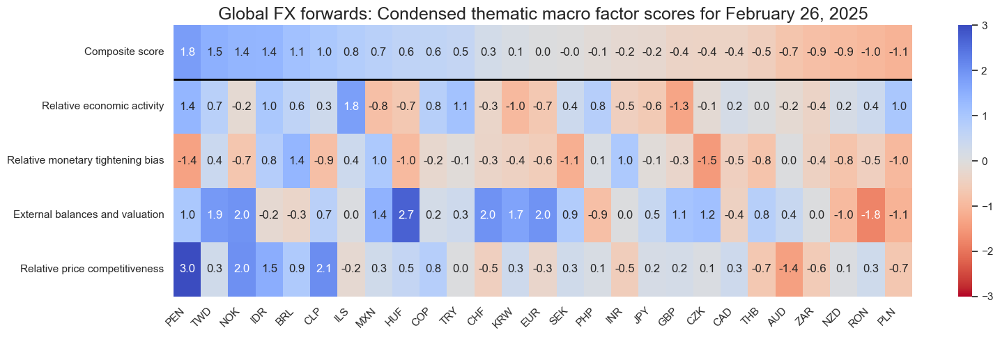

In [51]:
xcatx = list(dict_struct.keys())
cidx = cids_fx

# Set data of snapshot
backdate = datetime.strptime("2007-08-01", "%Y-%m-%d")
lastdate = datetime.strptime(end_date, "%Y-%m-%d")
snapdate = lastdate # lastdate or backdate

# Exclude all non-tradaeble currencies at snapshot date
exclude_cidx = [key[:3] for key in fxblack.keys() if snapdate in fxblack[key]]
cidx = [cid for cid in cidx if cid not in exclude_cidx]


sv_glb4 = ScoreVisualisers(
    df=dfx,
    cids=cidx,
    xcats = xcatx,
    no_zn_scores=False,
    rescore_composite=True,
    blacklist=fxblack,
)

sv_glb4.view_snapshot(
    cids=cidx,
    date=snapdate,
    transpose=True,
    sort_by_composite = True,
    title=f"Global FX forwards: Condensed thematic macro factor scores for {snapdate.strftime("%B %d, %Y")}",
    title_fontsize=18,
    figsize=(16, 5),
    xcats=xcatx + ["Composite"],
    xcat_labels=dict_lab,
    round_decimals=1,
)

Latest day:  2025-02-26 00:00:00


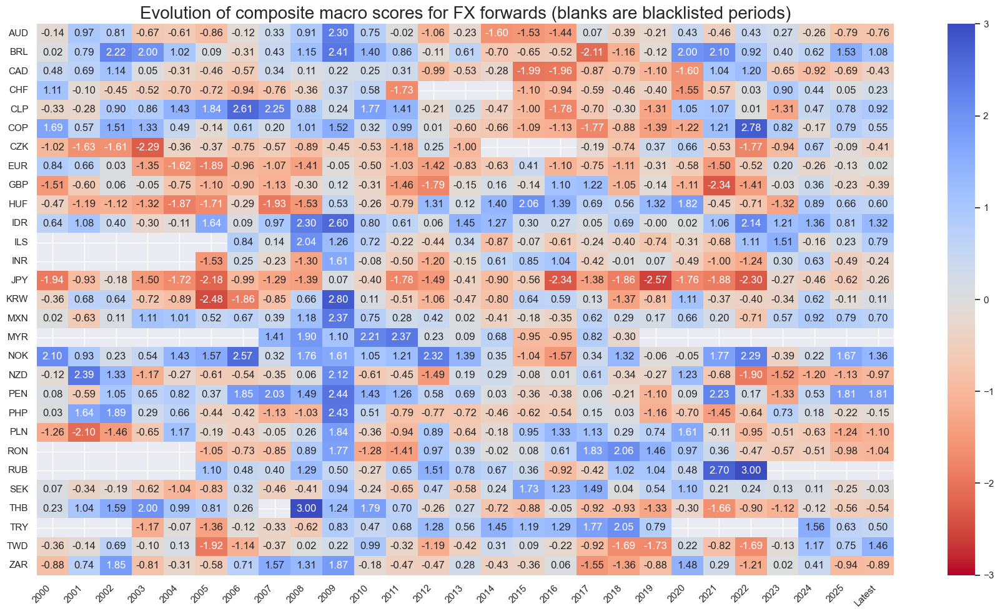

In [52]:
cidx = cids_fx
xcatx = list(dict_struct.keys())

svx = ScoreVisualisers(
    df=dfx,
    cids=cidx,
    xcats = xcatx,
    no_zn_scores=False,
    rescore_composite=True,
    blacklist=fxblack,
)

svx.view_score_evolution(
    xcat="Composite",
    cids=cidx,
    freq="A",
    include_latest_day=True,
    transpose=False,
    title="Evolution of composite macro scores for FX forwards (blanks are blacklisted periods)",
    start="2000-01-01",
    figsize=(18, 10),
)

Latest day:  2025-02-26 00:00:00


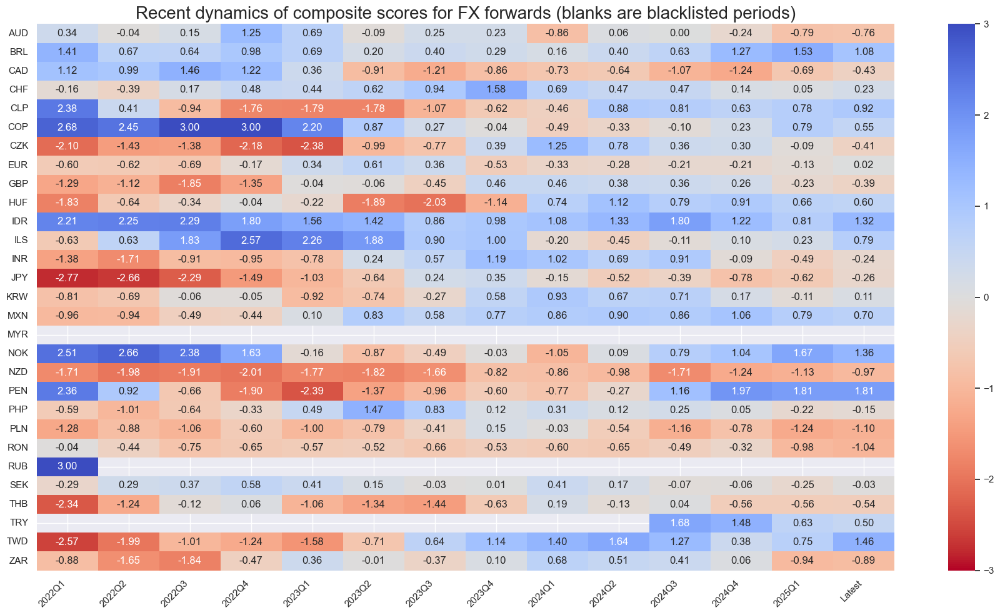

In [53]:
svx.view_score_evolution(
    xcat="Composite",
    cids=cidx,
    freq="Q",
    include_latest_day=True,
    transpose=False,
    title="Recent dynamics of composite scores for FX forwards (blanks are blacklisted periods)",
    start="2022-01-01",
    figsize=(18, 10),
)

### Thematic snapshot

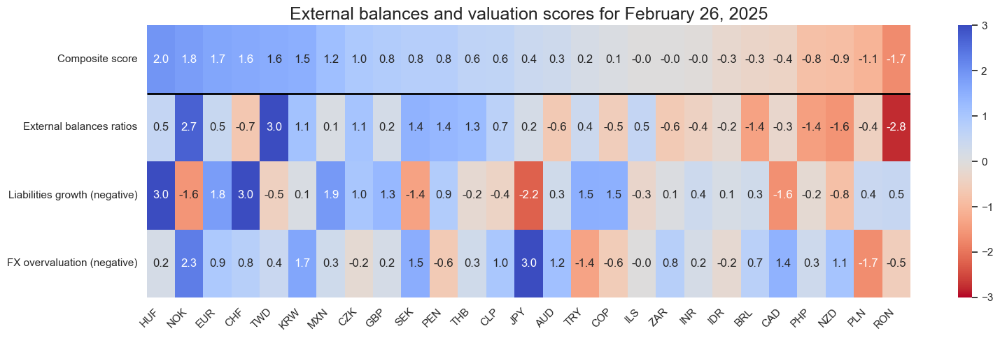

In [54]:
focus = 'EXTERNAL_VALUEZN'
dix = dict_struct_flat if focus in dict_struct_flat.keys() else dict_struct
label = dict_lab[focus]
xcatx = list(dix[focus])
cidx = cids_fx

# Set data of snapshot
backdate = datetime.strptime("2012-08-01", "%Y-%m-%d")
lastdate = datetime.strptime(end_date, "%Y-%m-%d")
snapdate = lastdate # lastdate or backdate

# Exclude all non-tradaeble currencies at snapshot date
exclude_cidx = [key[:3] for key in fxblack.keys() if snapdate in fxblack[key]]
cidx = [cid for cid in cidx if cid not in exclude_cidx]


sv_focus = ScoreVisualisers(
    df=dfx,
    cids=cidx,
    xcats = xcatx,
    no_zn_scores=False,
    rescore_composite=True,
)

sv_focus.view_snapshot(
    cids=cidx,
    date=snapdate,
    transpose=True,
    sort_by_composite = True,
    title=f"{label} scores for {snapdate.strftime("%B %d, %Y")}",
    title_fontsize=18,
    figsize=(16, 5),
    xcats=xcatx + ["Composite"],
    xcat_labels=dict_lab,
    round_decimals=1,
)

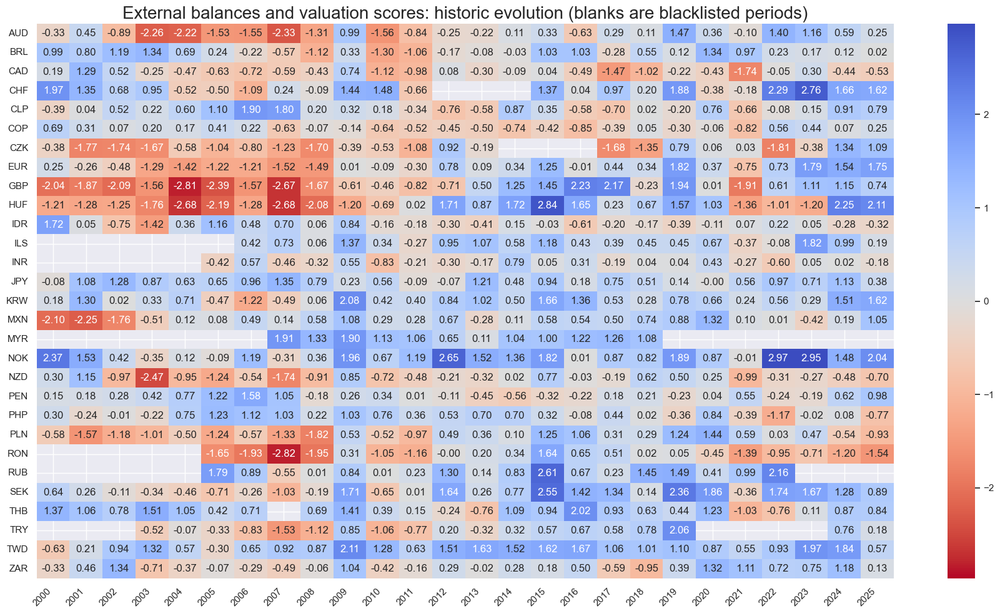

In [55]:
focus = 'EXTERNAL_VALUEZN'
dix = dict_struct_flat if focus in dict_struct_flat.keys() else dict_struct
label = dict_lab[focus]
xcatx = list(dix[focus])
cidx = cids_fx

sv_focus_x = ScoreVisualisers(
    df=dfx,
    cids=cidx,
    xcats = xcatx,
    no_zn_scores=False,
    rescore_composite=True,
    blacklist=fxblack,
)

sv_focus_x.view_score_evolution(
    xcat="Composite",
    cids=cidx,
    freq="A",
    include_latest_day=False,
    transpose=False,
    title=f"{label} scores: historic evolution (blanks are blacklisted periods)",
    start="2000-01-01",
    figsize=(18, 10),
)

### Country composite and thematic factor developments

Latest day:  2025-02-26 00:00:00


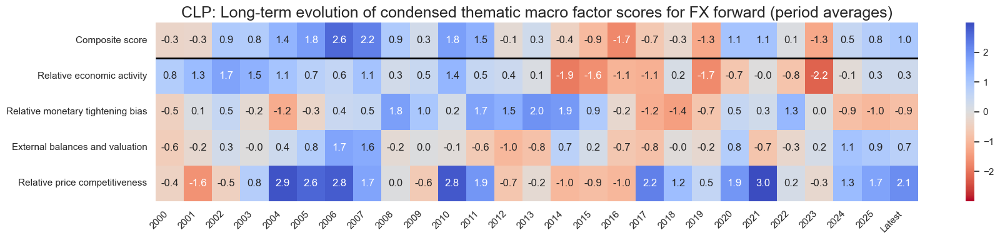

Latest day:  2025-02-26 00:00:00


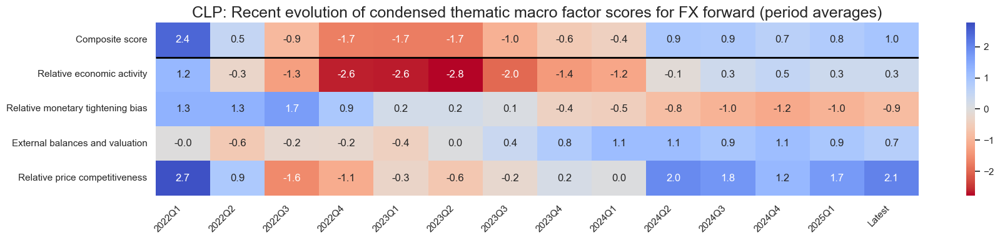

In [56]:
xcatx = list(dict_struct.keys()) + ["Composite"]
cid = "CLP"

sv_glb4.view_cid_evolution(
    cid=cid,
    xcats=xcatx,
    xcat_labels=dict_lab,
    freq="A",
    transpose=False,
    title=f"{cid}: Long-term evolution of condensed thematic macro factor scores for FX forward (period averages)",
    title_fontsize=18,
    figsize=(18, 4),
    round_decimals=1,
    start="2000-01-01",
)

sv_glb4.view_cid_evolution(
    cid=cid,
    xcats=xcatx,
    xcat_labels=dict_lab,
    freq="Q",
    transpose=False,
    title=f"{cid}: Recent evolution of condensed thematic macro factor scores for FX forward (period averages)",
    title_fontsize=18,
    figsize=(18, 4),
    round_decimals=1,
    start="2022-01-01",
)

### Drilling down 1 level: subordinate factor developments

In [57]:
sv_glb4_themes = {}
for theme in list(dict_struct.keys()):
    sv_glb4_themes[theme] = ScoreVisualisers(
        dfx,
        cids=cidx,
        xcats=list(dict_struct[theme]),
        thresh=3,
        no_zn_scores=True,
        complete_xcats=False,
        rescore_composite=True,
    )

Latest day:  2025-02-26 00:00:00


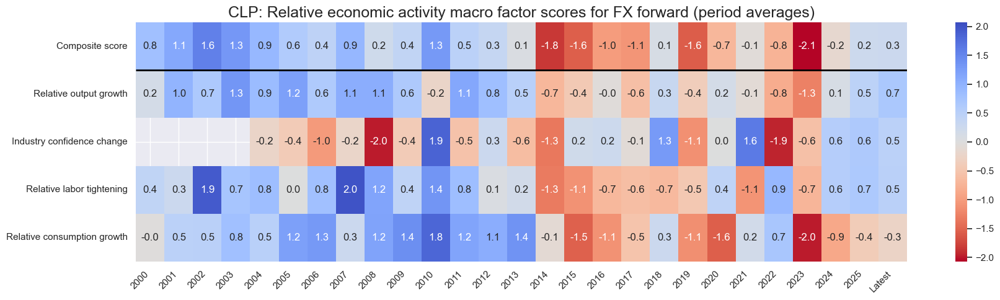

Latest day:  2025-02-26 00:00:00


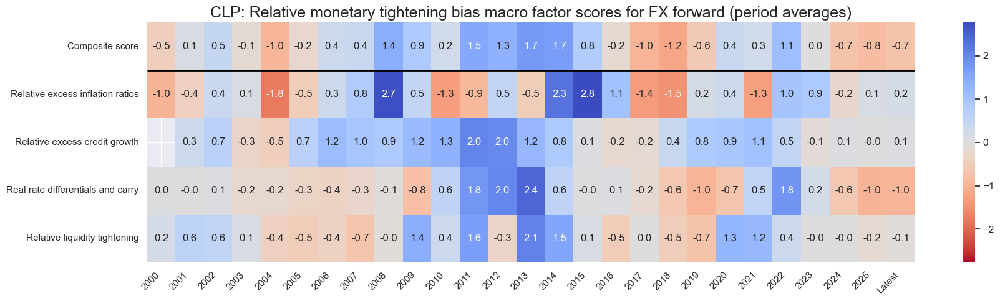

Latest day:  2025-02-26 00:00:00


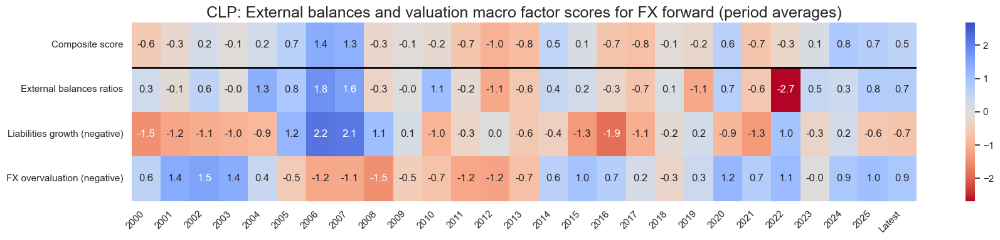

Latest day:  2025-02-26 00:00:00


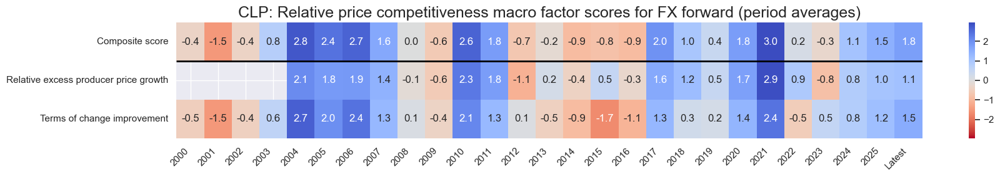

In [58]:
cid = "CLP"

for i in sv_glb4_themes:
    xcatx = list(dict_struct[i]) + ["Composite"]
    sv_glb4_themes[i].view_cid_evolution(
        cid=cid,
        xcats=xcatx,
        xcat_labels=dict_lab,
        freq="A",
        transpose=False,
        title=f"{cid}: {dict_lab[i]} macro factor scores for FX forward (period averages)",
        title_fontsize=18,
        figsize=(18, len(xcatx)),
        round_decimals=1,
        start="2000-01-01",
    )

### Drilling down 2 levels: constituent developments

In [59]:
cidx = cids_fx
xcatx = list(dict_struct_flat.keys())

sv_glb4_factors = {}
for fact in list(dict_struct_flat.keys()):
    if fact == "MBC_CHANGEZN":
       cidx = list(set(cids_fx) - set(["THB"]))
    elif fact == "LAB_TIGHTZN":
        cidx = list(set(cids_fx) - set(["IDR", "INR"]))
    else:
        cidx = cids_fx
    sv_glb4_factors[fact] = ScoreVisualisers(
        dfx,
        cids=cidx,
        xcats=[constituent for constituent in dict_struct_flat[fact]],
        xcat_labels=dict_lab,
        thresh=3,
        no_zn_scores=True,
        complete_xcats=False,
        rescore_composite=True,
    )

Latest day:  2025-02-26 00:00:00


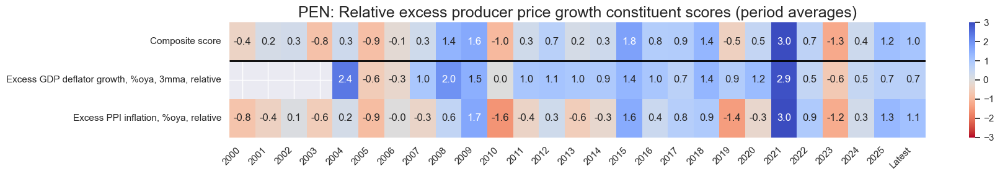

Latest day:  2025-02-26 00:00:00


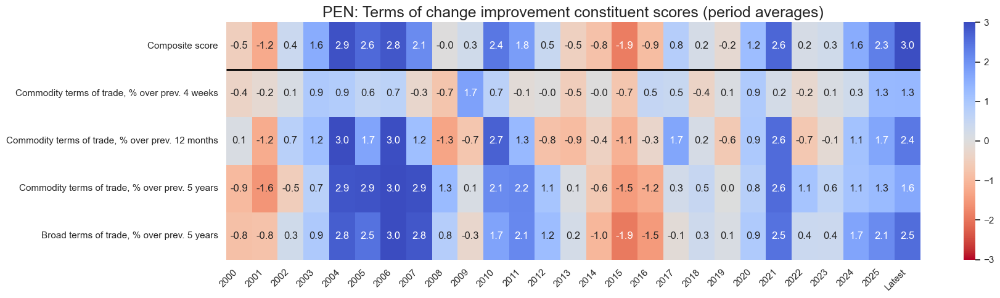

In [60]:
cid = "PEN"
theme = "REL_PRICE_COMPETEZN"   # 'REL_ECON_GROWTHZN', 'REL_MONPOL_TIGHTZN', 'EXTERNAL_VALUEZN', 'REL_PRICE_COMPETEZN'


factors = dict_struct[theme].keys()
svx = {fact: sv_glb4_factors[fact] for fact in factors}

for i in svx:
    xcatx = [xc for xc in list(dict_struct_flat[i])] + ["Composite"]
    sv_glb4_factors[i].view_cid_evolution(
        cid=cid,
        xcats=xcatx,
        xcat_labels=dict_lab,
        freq="A",
        transpose=False,
        title=f"{cid}: {dict_lab[i]} constituent scores (period averages)",
        title_fontsize=18,
        figsize=(18, len(xcatx)),
        round_decimals=1,
        start="2000-01-01",
    )

### Predictive power

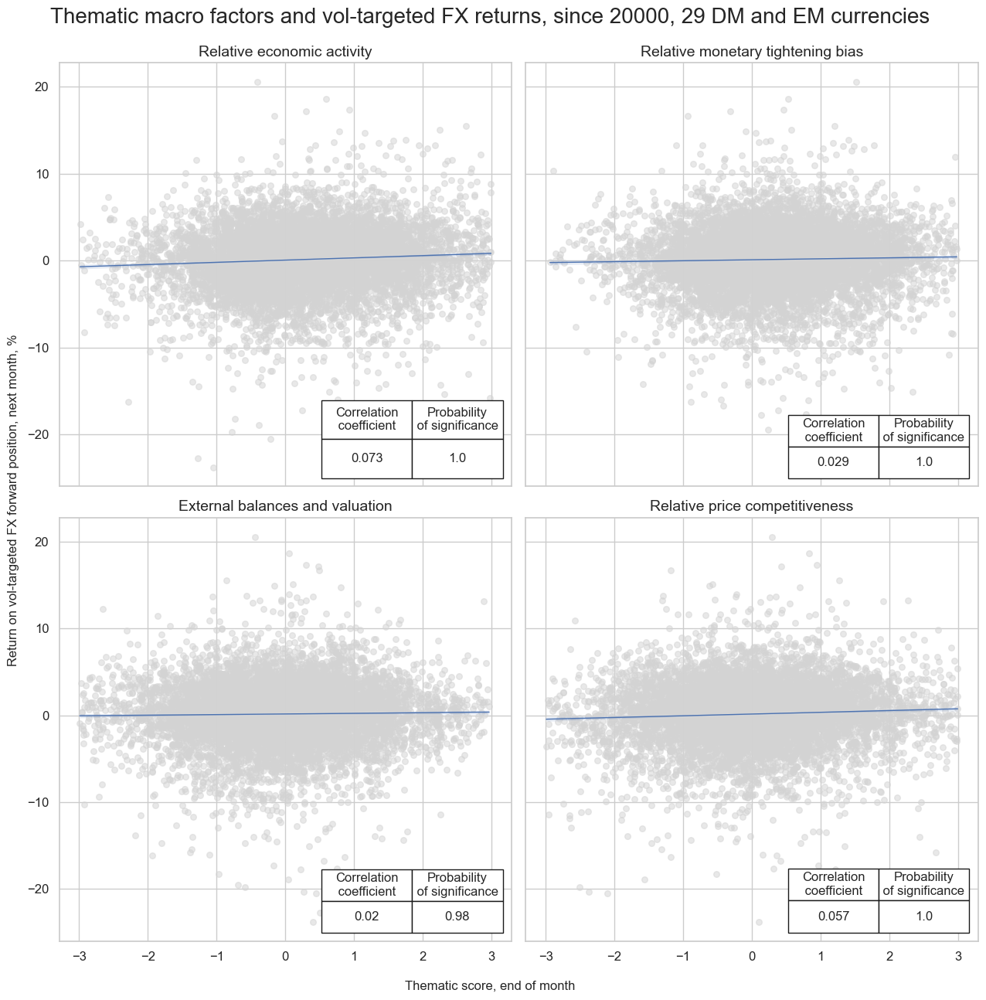

In [61]:
sigx = list(dict_struct.keys())
ret = "FXXR_VT10"
cidx = cids_fx
freq = "m"
start = "2000-01-01"

catregs = {}
for sig in sigx:
    catregs[sig] = msp.CategoryRelations(
        dfx,
        xcats=[sig, ret],
        cids=cidx,
        freq=freq,
        lag=1,
        xcat_aggs=["last", "sum"],
        start=start,
        blacklist=fxblack,
        xcat_trims=[3, 30]  # remove single outlier for charts
    )

msv.multiple_reg_scatter(
    cat_rels=[v for k, v in catregs.items()],
    ncol=2,
    nrow=2,
    figsize=(13, 13),
    title="Thematic macro factors and vol-targeted FX returns, since 20000, 29 DM and EM currencies",
    xlab="Thematic score, end of month",
    ylab="Return on vol-targeted FX forward position, next month, %",
    coef_box="lower right",
    prob_est="map",
    single_chart=True,
    subplot_titles=[dict_lab[sig] for sig in sigx],
)

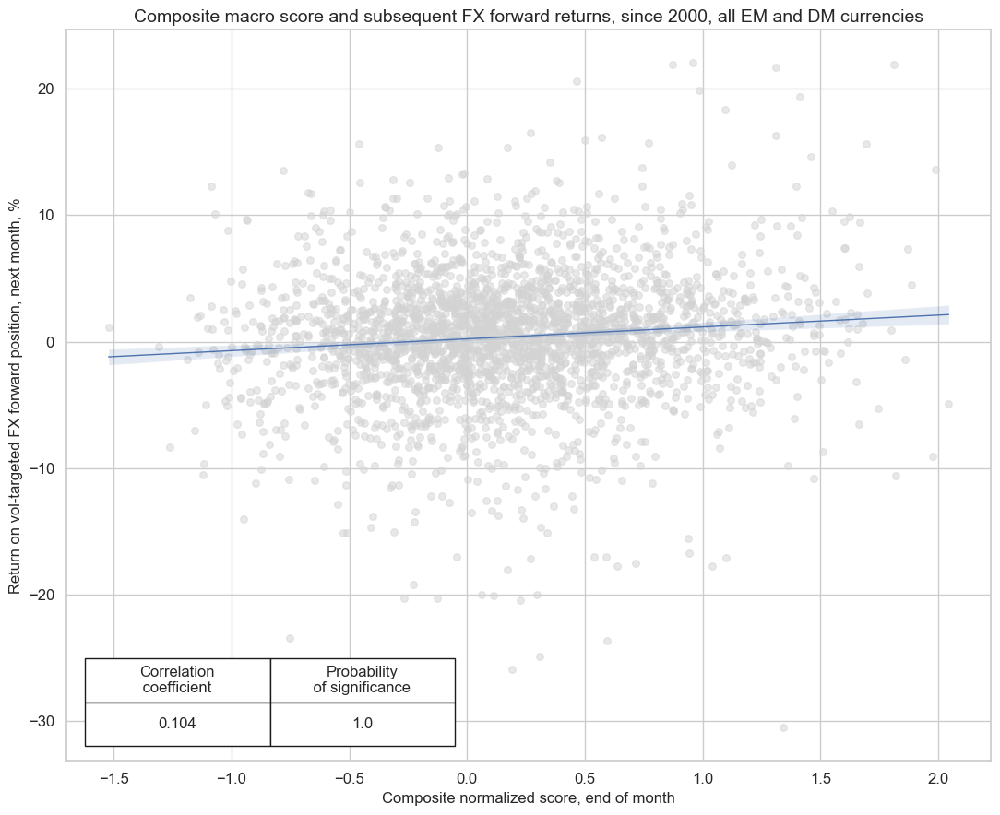

In [62]:
sig = "COMPOSITE"
ret = "FXXR_NSA"
cidx = cids_fx
freq = "m"
start = "2000-01-01"

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, ret],
    cids=cidx,
    freq="Q",
    lag=1,
    slip=1,
    xcat_aggs=["last", "sum"],
    start=start,
    blacklist=fxblack,
)

crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Composite normalized score, end of month",
    ylab="Return on vol-targeted FX forward position, next month, %",
    title="Composite macro score and subsequent FX forward returns, since 2000, all EM and DM currencies",
    size=(11, 9),
    prob_est="map",
)

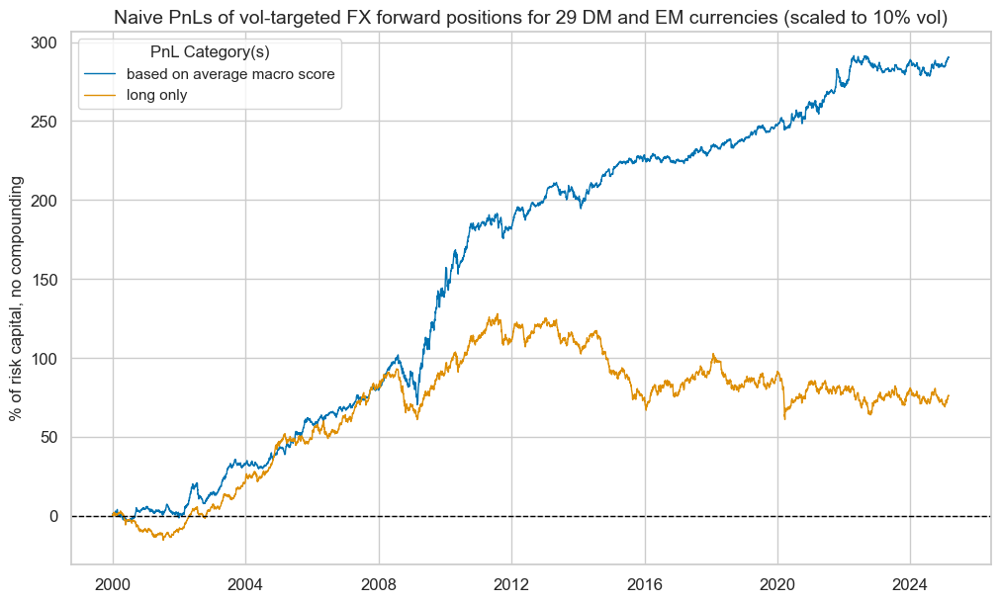

xcat,PNL_COMPOSITE,Long only
Return %,11.541294,3.022929
St. Dev. %,10.0,10.0
Sharpe Ratio,1.154129,0.302293
Sortino Ratio,1.709637,0.414842
Max 21-Day Draw %,-15.363176,-23.478791
Max 6-Month Draw %,-23.875106,-26.723264
Peak to Trough Draw %,-31.634174,-67.08462
Top 5% Monthly PnL Share,0.501389,1.488394
USD_GB10YXR_NSA correl,-0.106215,-0.04457
EUR_FXXR_NSA correl,0.207925,0.453604


In [63]:

sig = "COMPOSITE"
targ = "FXXR_VT10"
cidx = cids_fx
blax = fxblack
sdate = "2000-01-01"

pnls = msn.NaivePnL(
    df=dfx,
    ret=targ,
    sigs=[sig],
    cids=cidx,
    start=sdate,
    blacklist=blax,
    bms=["USD_GB10YXR_NSA", "EUR_FXXR_NSA", "USD_EQXR_NSA"],
)

pnls.make_pnl(
    sig=sig,
    sig_op="raw",
    rebal_freq="monthly",
    neutral="zero",
    rebal_slip=1,
    vol_scale=10,
)
pnls.make_long_pnl(vol_scale=10, label="Long only")

pnls.plot_pnls(
    title="Naive PnLs of vol-targeted FX forward positions for 29 DM and EM currencies (scaled to 10% vol)",
    title_fontsize=14,
    xcat_labels=["based on average macro score", "long only"],
)
display(pnls.evaluate_pnls(["PNL_COMPOSITE", "Long only"]))


MBC_CHANGEZN misses: ['THB'].
LAB_TIGHTZN misses: ['IDR', 'INR'].


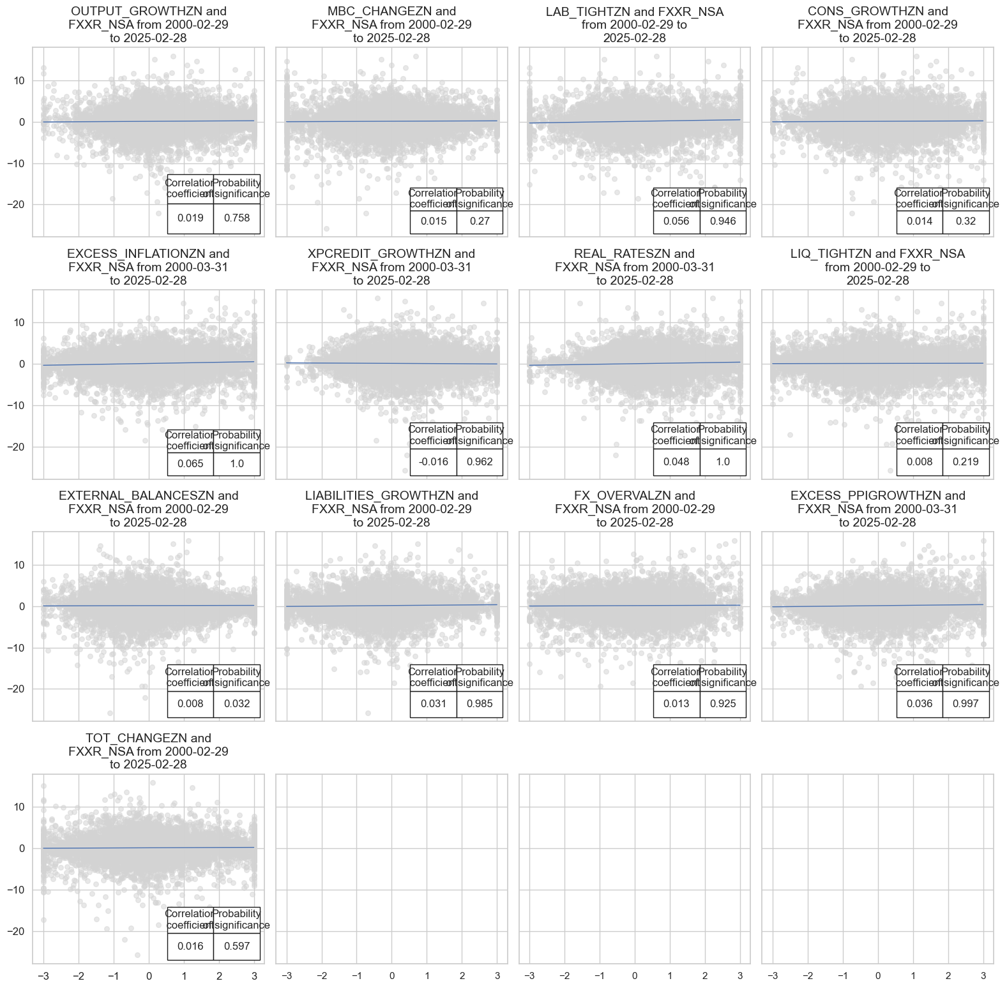

In [64]:
sigx = list(dict_struct_flat.keys())
ret = "FXXR_NSA"
cidx = cids_fx
freq = "m"
start = "2000-01-01"

catregs = {}
for sig in sigx:
    catregs[sig] = msp.CategoryRelations(
        dfx,
        xcats=[sig, ret],
        cids=cidx,
        freq=freq,
        lag=1,
        xcat_aggs=["last", "sum"],
        start=start,
        blacklist=fxblack,
        # xcat_trims=[3, 20]  # for presentation purposes only
    )

msv.multiple_reg_scatter(
    cat_rels=[v for k, v in catregs.items()],
    ncol=4,
    nrow=4,
    figsize=(16, 16),
    title=None,
    xlab=None,
    ylab=None,
    coef_box="lower right",
    prob_est="map",
    single_chart=True,
    # subplot_titles=[dict_groups_labels[key] for key in sigx],
)